In [222]:
from astroquery.skyview import SkyView
from astropy import coordinates as coords
from astropy import units as u
from astropy.wcs import WCS
from astropy.visualization import SqrtStretch
from astropy.visualization import make_lupton_rgb
from astropy.visualization.mpl_normalize import ImageNormalize
from matplotlib import pyplot as plt
import numpy as np
print('imports are done')

imports are done


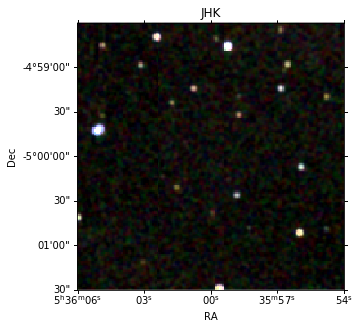

In [238]:
def stretch(image, vmin=0.01, vmax=0.99):
    """
      Simple routine for linear scaling an image, avoiding outlier pixels
      before properly displaying it.
      
      Input:
          image (numpy.array)
          vmin (float): minimum intensity to stretch (in percentage values, from 0 to 1)
          vmax (float): maximum intensity to stretch (in percentage values, from 0 to 1)
      
      Output: image (numpy.array)
      
      Dependencies: NumPy
    """
    
    quant = np.quantile(image,[vmin,vmax])
    
    image = (image - quant[0]) / (quant[1] - quant[0])
    image[image < 0] = 0
    image[image > 1] = 1
    return image

def query_2mass(center_ra, center_dec, fov, minmax=[0.001,0.999], output=None, sqrt=False):
    """
      Given RA and Dec coordinates, query for images from the 2MASS catalog
      and plot them side-by-side.
      
      Input: center_ra (in degrees)
             center_dec (in degrees)
             fov (in armin)
             minmax (float): minimum and maximum intensity to stretch the image (in percentage values, from 0 to 1)
             output (str): full location (path + image name) to save the resulting image (in png format)
             sqrt (bool): if True, use a Srqt scaling for displaying the images.
             
      Output: png-format image and on-screen display.
      
    """
    
    pos = coords.SkyCoord(center_ra,center_dec,frame='icrs',unit='degree')
    fov = fov / 60 # from arcmin to degrees
    
    query_j = SkyView.get_images(pos, survey=['2MASS-J'], height=size*u.degree, width=size*u.degree, coordinates='icrs')
    query_h = SkyView.get_images(pos, survey=['2MASS-H'], height=size*u.degree, width=size*u.degree, coordinates='icrs')
    query_k = SkyView.get_images(pos, survey=['2MASS-K'], height=size*u.degree, width=size*u.degree, coordinates='icrs')
    
    wcs = WCS(query_k[0][0].header)
    
    imgJ = stretch(query_j[0][0].data, vmin=minmax[0], vmax=minmax[1])
    imgH = stretch(query_h[0][0].data, vmin=minmax[0], vmax=minmax[1])
    imgK = stretch(query_k[0][0].data, vmin=minmax[0], vmax=minmax[1])
        
    if sqrt is True:
        # Create normalizer object
        normJ = ImageNormalize(imgJ, stretch=SqrtStretch(), clip=True)
        normH = ImageNormalize(imgH, stretch=SqrtStretch(), clip=True)
        normK = ImageNormalize(imgK, stretch=SqrtStretch(), clip=True)
    else:
        normJ = ImageNormalize(imgJ, clip=True)
        normH = ImageNormalize(imgH, clip=True)
        normK = ImageNormalize(imgK, clip=True)

        
    # plot results
    plt.figure(figsize=(15,4.2))
    ax_j=plt.subplot(1,3,1,projection=wcs)
    ax_h=plt.subplot(1,3,2,projection=wcs)
    ax_k=plt.subplot(1,3,3,projection=wcs)
    
    xtitle = 'RA'
    ytitle = 'Dec'
    title_j = "J-band"
    title_h = "H-band"
    title_k = "Ks-band"
    
    ax_j.imshow(imgJ, interpolation='none',aspect='equal', origin='lower', cmap='Blues', norm=normJ)
    ax_j.set_title(title_j)
    ax_j.set_xlabel(xtitle)
    ax_j.set_ylabel(ytitle)
    
    ax_h.imshow(imgH, interpolation='none',aspect='equal', origin='lower', cmap='Greens', norm=normH)
    ax_h.set_title(title_h)
    ax_h.set_xlabel(xtitle)
    ax_h.set_ylabel(' ')
        
    
    ax_k.imshow(imgK, interpolation='none',aspect='equal', origin='lower', cmap='Reds', norm=normK)
    ax_k.set_title(title_k)
    ax_k.set_xlabel(xtitle)
    ax_k.set_ylabel(' ')
    
    if output is not None:
        plt.savefig(output, format='png')
        
    plt.tight_layout()
    plt.show()


def query_2mass_rgb(center_ra, center_dec, fov, minmax=[0.100,0.999], output=None, rgb_Q=2, rgb_stretch=0.25):
    """
      Given RA and Dec coordinates, query for images from the 2MASS catalog
      and plot an RGB image using J, H and K images.
      
      Input: center_ra (in degrees)
             center_dec (in degrees)
             fov (in armin)
             minmax (float): minimum and maximum intensity to stretch the image (in percentage values, from 0 to 1)
             output (str): full location (path + image name) to save the resulting image (in png format)
             rgb_Q (float): The asinh softening parameter (common values: from 0.5 to 2, 1 is linear).
             rgb_stretch (float): The linear stretch of the image (from 0 to 1)
             
      Output: png-format image and on-screen display.
      
    """

    pos = coords.SkyCoord(center_ra,center_dec,frame='icrs',unit='degree')
    
    fov = size / 60 # from arcmin to degrees
    
    query_j = SkyView.get_images(pos, survey=['2MASS-J'], height=size*u.degree, width=size*u.degree, coordinates='icrs')
    query_h = SkyView.get_images(pos, survey=['2MASS-H'], height=size*u.degree, width=size*u.degree, coordinates='icrs')
    query_k = SkyView.get_images(pos, survey=['2MASS-K'], height=size*u.degree, width=size*u.degree, coordinates='icrs')
    
    wcs = WCS(query_k[0][0].header)
    
    imgJ = stretch(query_j[0][0].data, vmin=minmax[0], vmax=minmax[1])
    imgH = stretch(query_h[0][0].data, vmin=minmax[0], vmax=minmax[1])
    imgK = stretch(query_k[0][0].data, vmin=minmax[0], vmax=minmax[1])
        
    image = make_lupton_rgb(imgK, imgH, imgJ, Q=rgb_Q, stretch=rgb_stretch)
    
    # plot results
    plt.figure(figsize=(5,5))
    ax=plt.subplot(projection=wcs)
    title='JHK'
    xtitle = 'RA'
    ytitle = 'Dec'
    
    ax.imshow(image, interpolation='none',aspect='equal', origin='lower') #, cmap='Blues', norm=normJ)
    ax.set_title(title)
    ax.set_xlabel(xtitle)
    ax.set_ylabel(ytitle)
    
    if output is not None:
        plt.savefig(output, format='png')
        
    plt.tight_layout()
    plt.show()
    
#query_2mass(84, -5, 3.0, output='C:/Users/navar/Downloads/top100_2mass/test.png', sqrt=False)
#query_2mass(84, -5, 3.0, output='C:/Users/navar/Downloads/top100_2mass/test.png', sqrt=True)
query_2mass_rgb(84, -5, 3.0, output='C:/Users/navar/Downloads/top100_2mass/test_rgb.png')

In [158]:
import numpy as np
from astropy.io import ascii
from astropy.table import Table
data = ascii.read("C:/Users/navar/Downloads/asu.tsv", data_start=2) 
data


ID,CSC,RAJ2000,DEJ2000,OffX,OfFY,GCSC,OfFXg,OfFYg,Vlsr,Dist,logL,logM,Class,Simbad
int32,str18,str11,str11,float64,float64,str16,float64,float64,float64,float64,float64,float64,str3,str6
1,AGAL008.684-00.367,18 06 23.27,-21 37 12.7,2.5,6.8,G008.6834-0.3675,1.9,4.7,37.3,4.8,4.44,3.17,IRw,Simbad
2,AGAL008.706-00.414,18 06 36.81,-21 37 18.1,-1.9,-1.7,G008.7064-0.4136,-1.3,1.5,37.6,4.8,2.7,3.22,IRw,Simbad
3,AGAL010.444-00.017,18 08 44.94,-19 54 32.0,-3.2,-4.7,G010.4446-0.0178,-0.8,-4.0,74.8,8.6,4.05,3.21,IRw,Simbad
4,AGAL010.472+00.027,18 08 38.24,-19 51 49.6,-1.0,0.6,G010.4722+0.0277,-3.1,0.3,66.3,8.6,5.67,4.02,HII,Simbad
5,AGAL010.624-00.384,18 10 28.87,-19 55 47.4,0.0,-0.7,G010.6237-0.3833,-4.6,-0.6,-2.8,5.0,5.63,3.58,HII,Simbad
6,AGAL012.804-00.199,18 14 13.75,-17 55 31.2,-5.4,-13.6,G012.8057-0.1994,-2.9,-9.2,35.3,2.4,5.39,3.27,HII,Simbad
7,AGAL013.178+00.059,18 14 00.77,-17 28 37.8,6.8,-2.1,G013.1768+0.0599,2.9,-3.0,49.3,2.4,3.92,2.57,70w,Simbad
8,AGAL013.658-00.599,18 17 24.25,-17 22 11.9,1.2,2.1,G013.6570-0.5992,1.6,0.7,47.4,4.5,4.32,2.76,IRb,Simbad
9,AGAL014.114-00.574,18 18 13.21,-16 57 17.4,-0.5,-2.3,G014.1145-0.5745,1.6,-2.0,19.5,2.6,3.5,2.55,IRw,Simbad


AGAL008.684-00.367


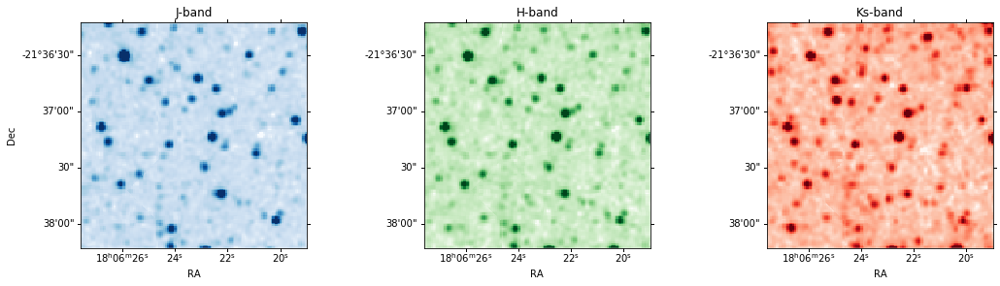

AGAL008.706-00.414


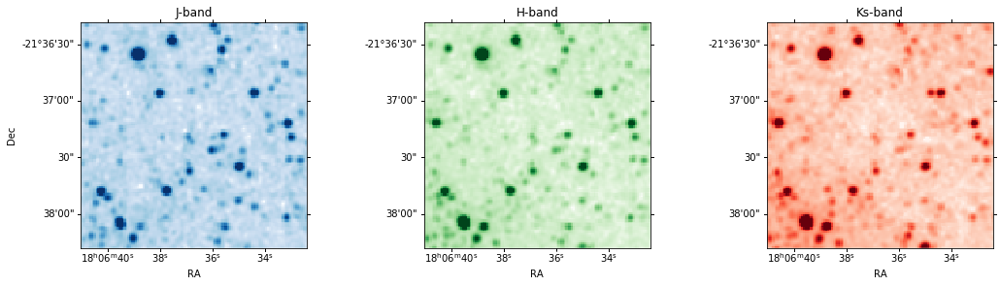

AGAL010.444-00.017


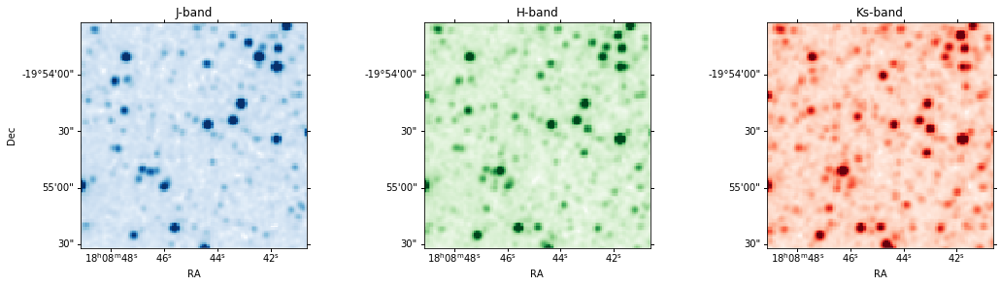

AGAL010.472+00.027


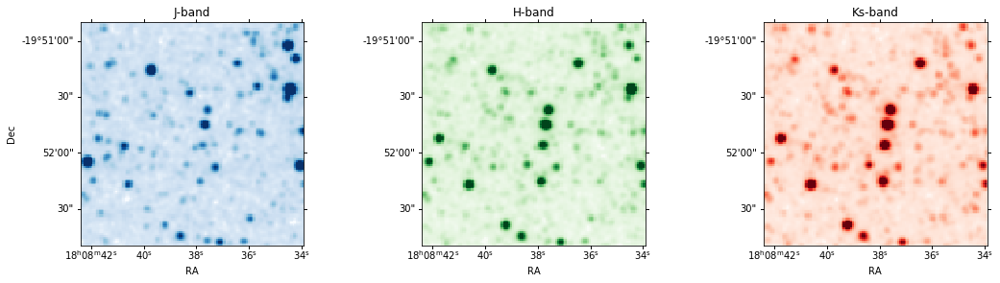

AGAL010.624-00.384


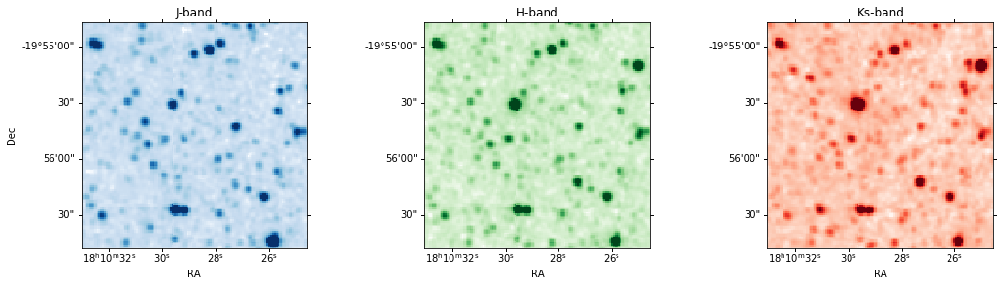

AGAL012.804-00.199


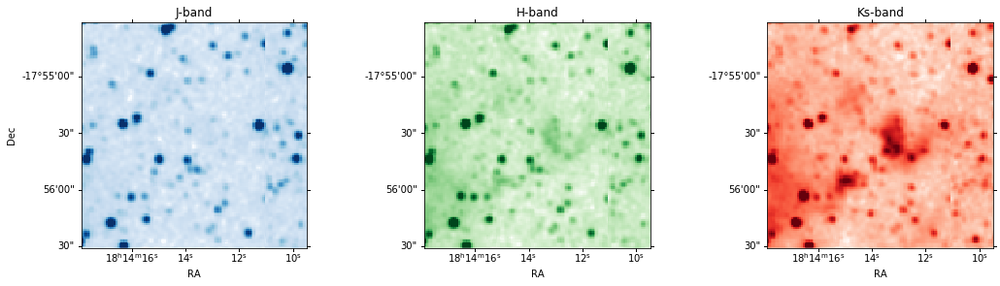

AGAL013.178+00.059


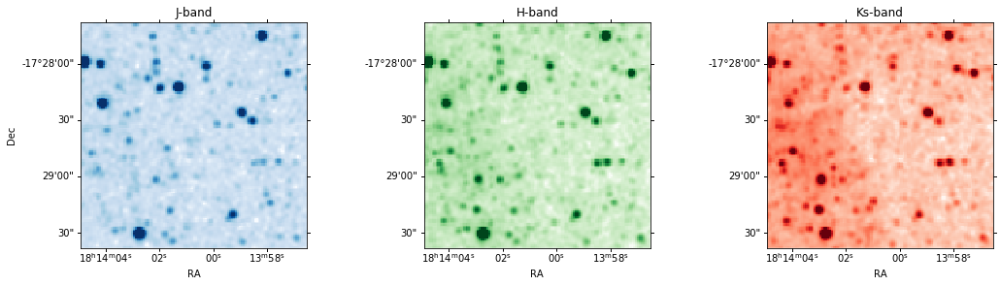

AGAL013.658-00.599


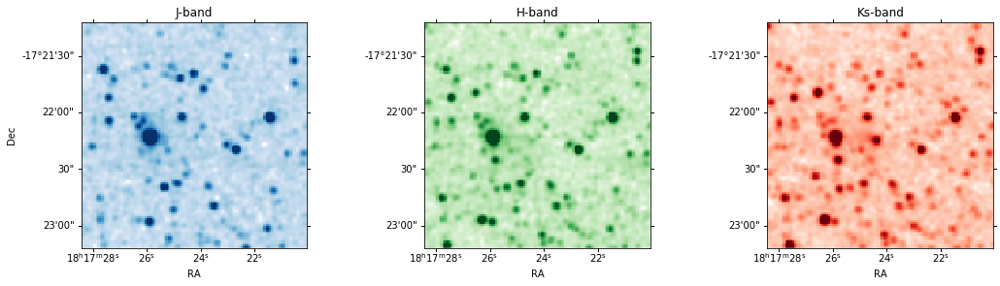

AGAL014.114-00.574


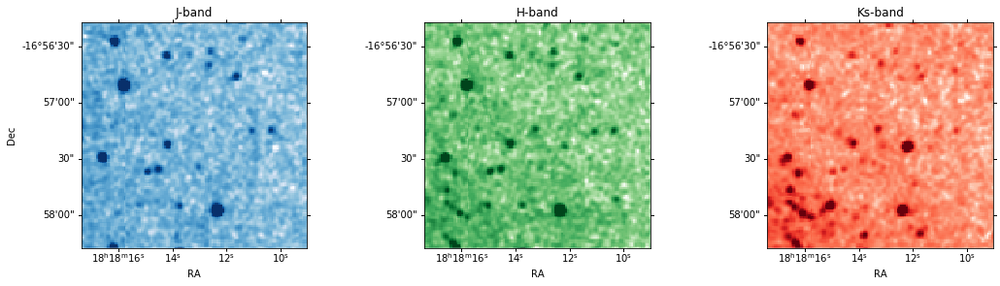

AGAL014.194-00.194


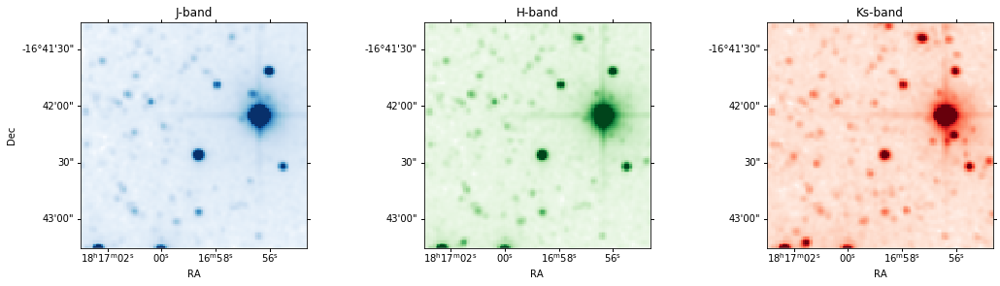

AGAL014.492-00.139


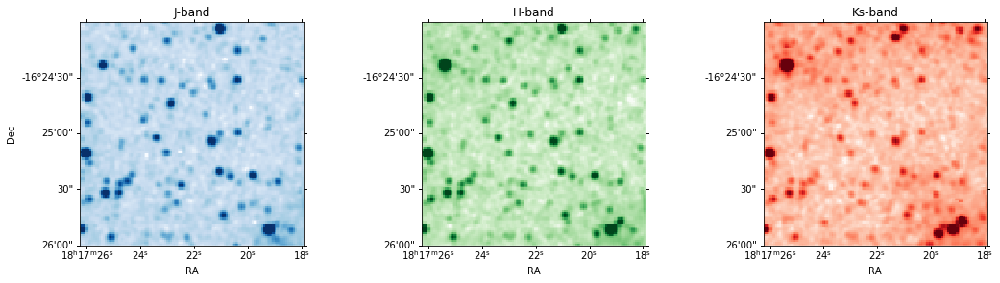

AGAL014.632-00.577


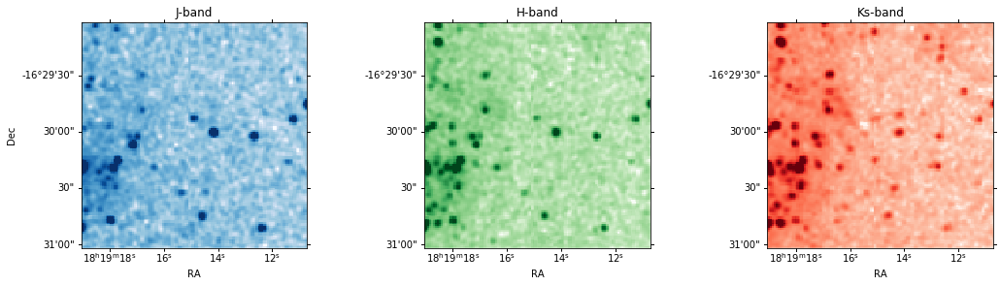

AGAL015.029-00.669


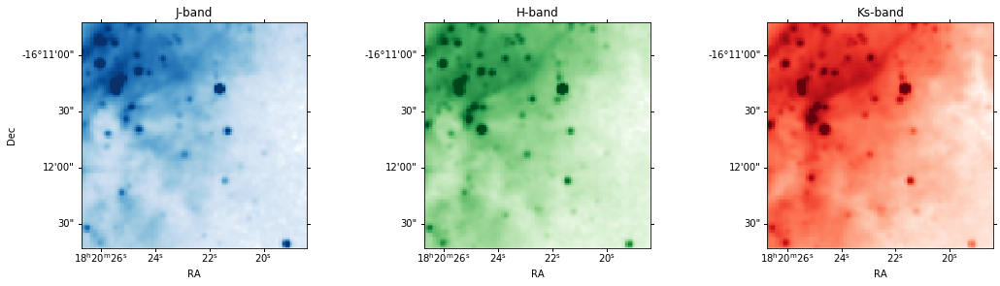

AGAL018.606-00.074


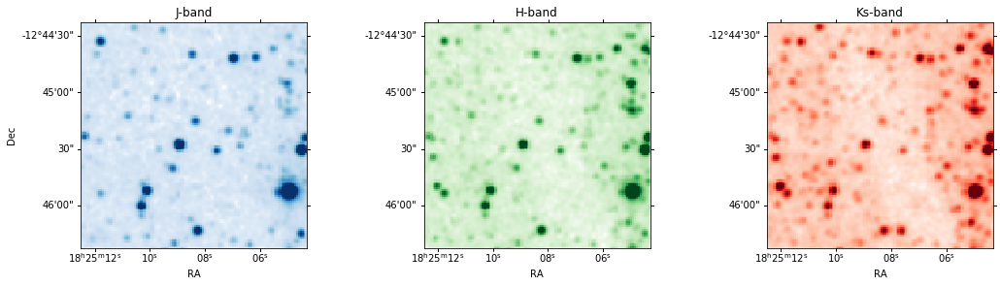

AGAL018.734-00.226


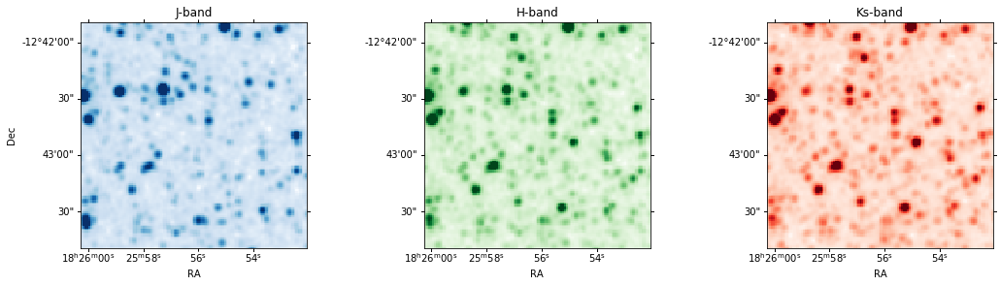

AGAL018.888-00.474


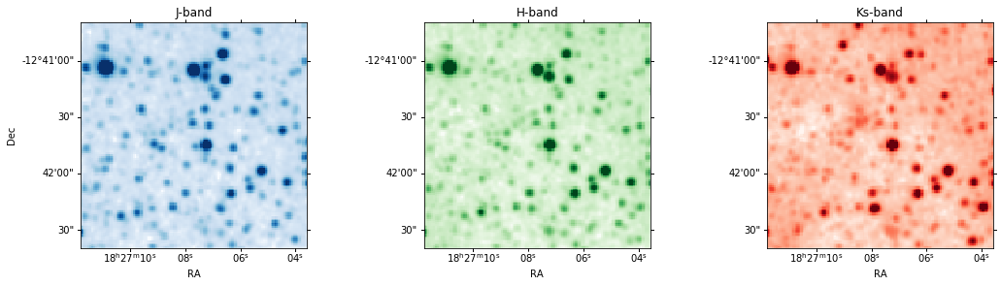

AGAL019.882-00.534


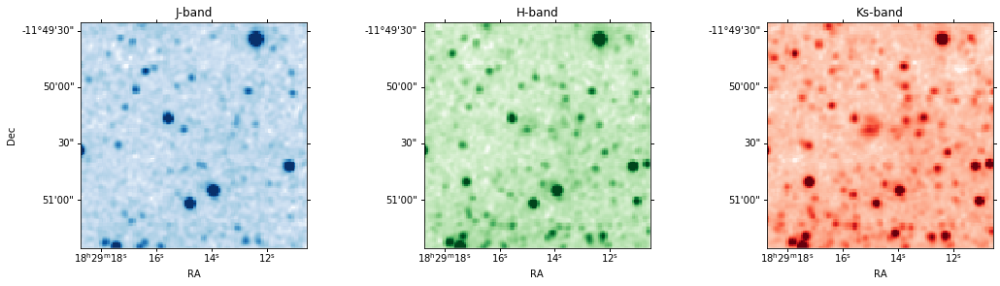

AGAL022.376+00.447


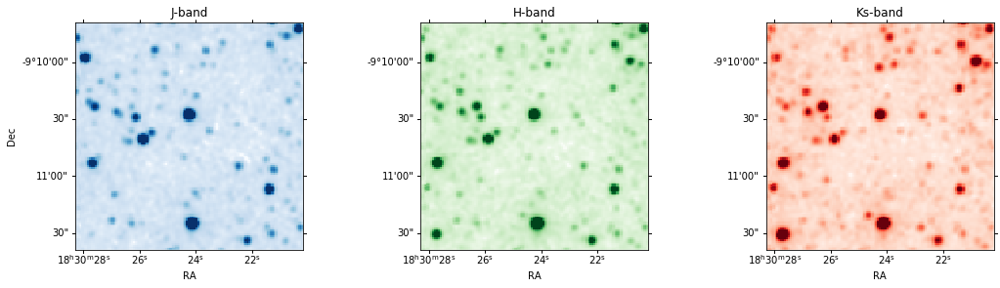

AGAL023.206-00.377


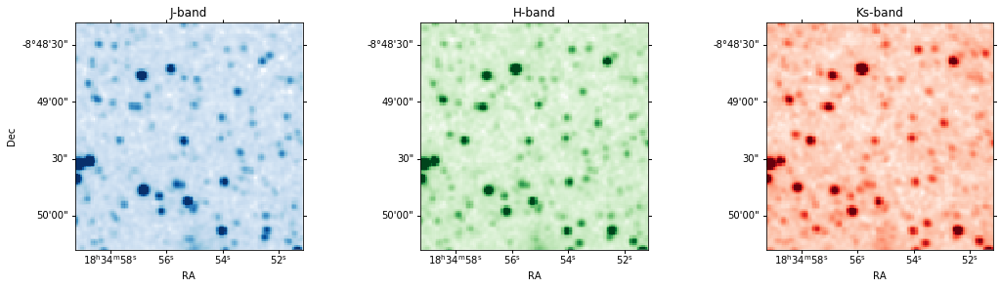

AGAL024.629+00.172


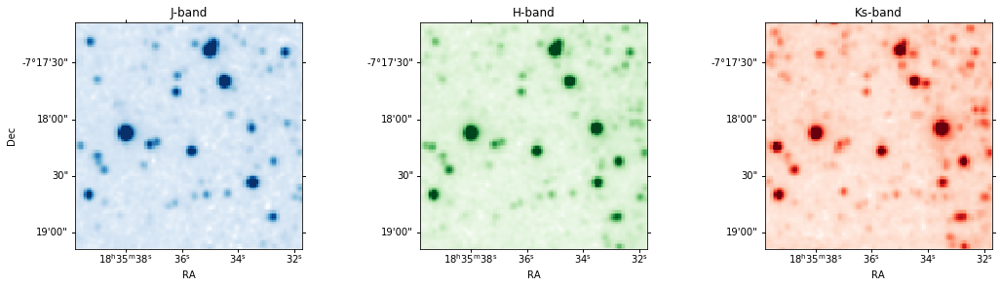

AGAL028.564-00.236


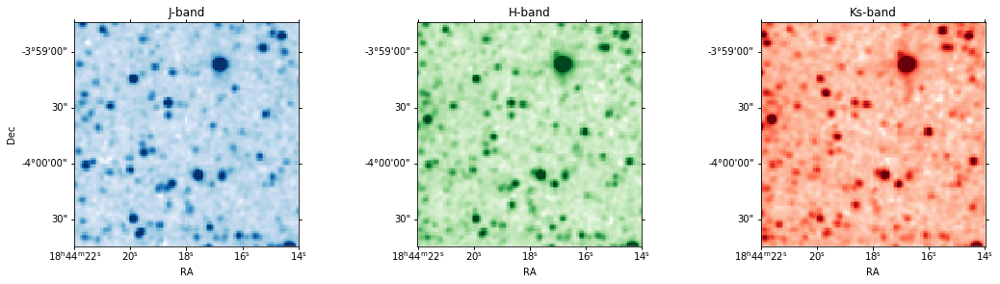

AGAL028.861+00.066


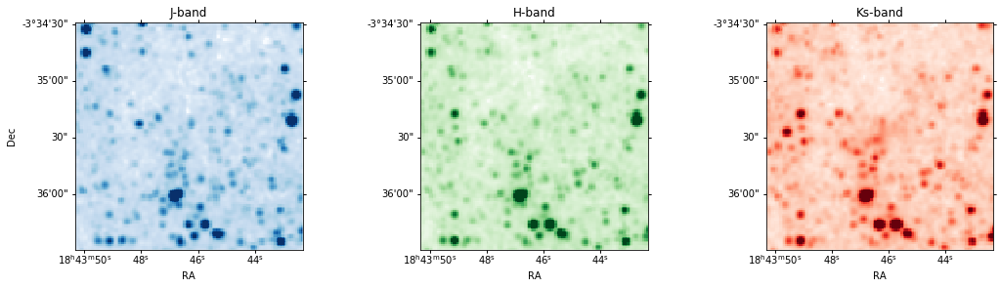

AGAL030.818-00.056


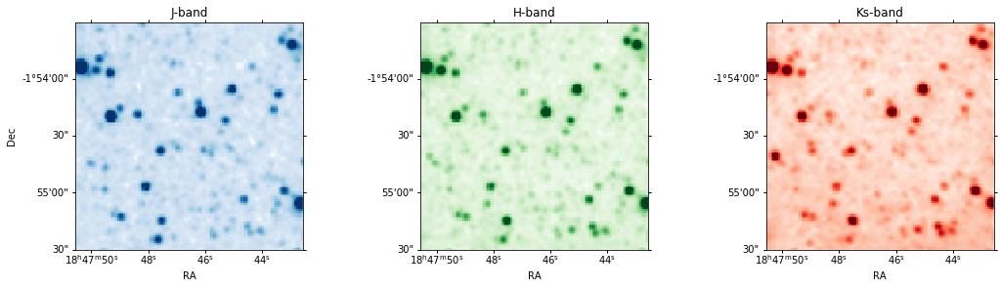

AGAL030.848-00.081


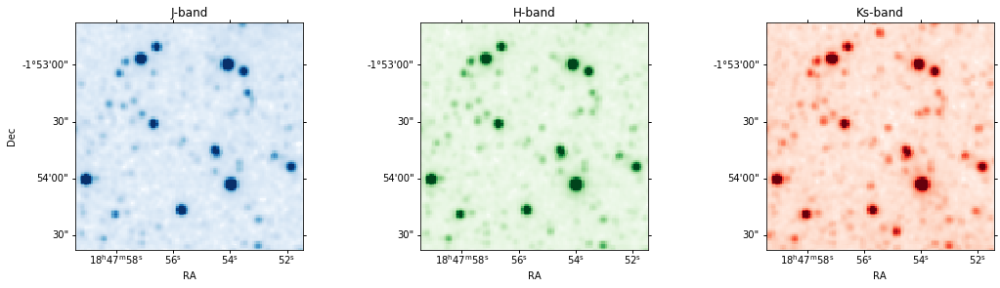

AGAL030.893+00.139


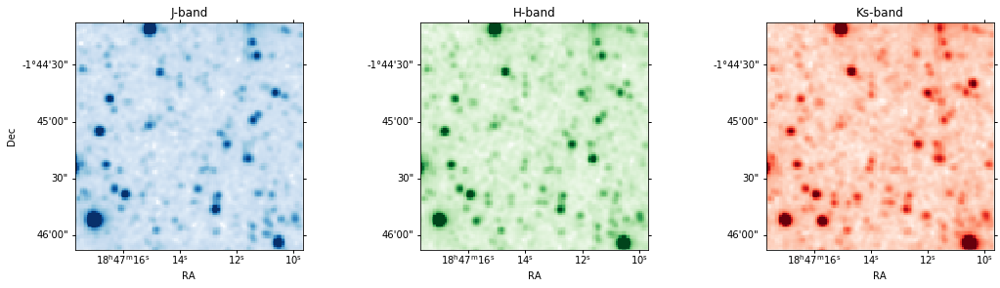

AGAL031.412+00.307


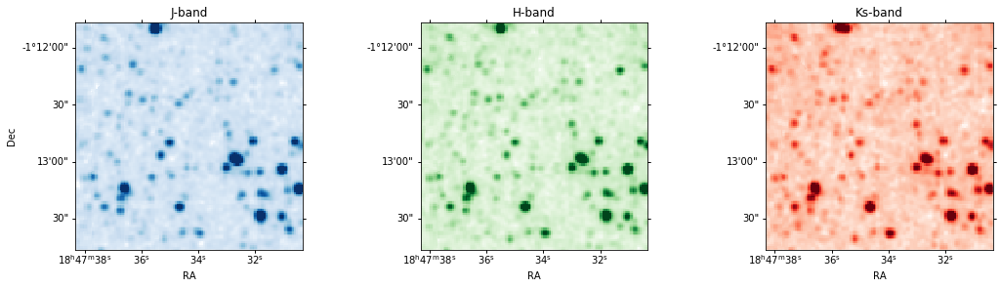

AGAL034.258+00.154


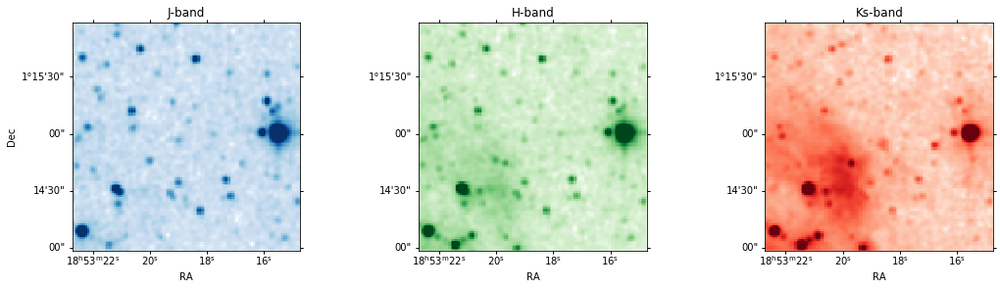

AGAL034.401+00.226


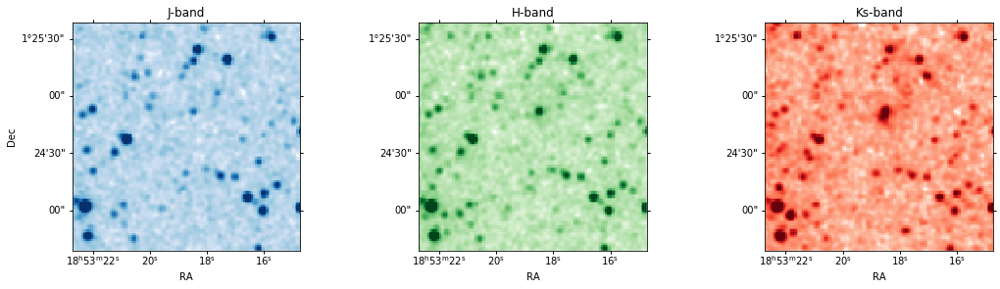

AGAL034.411+00.234


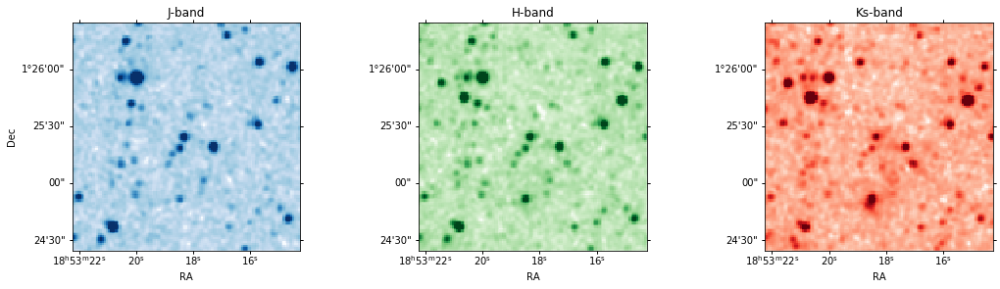

AGAL034.821+00.351


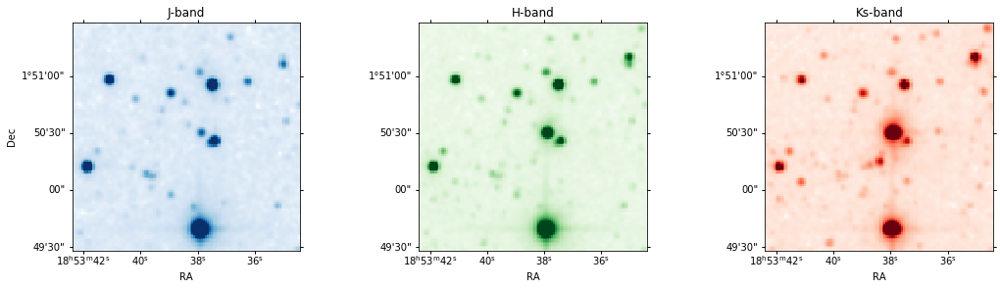

AGAL035.197-00.742


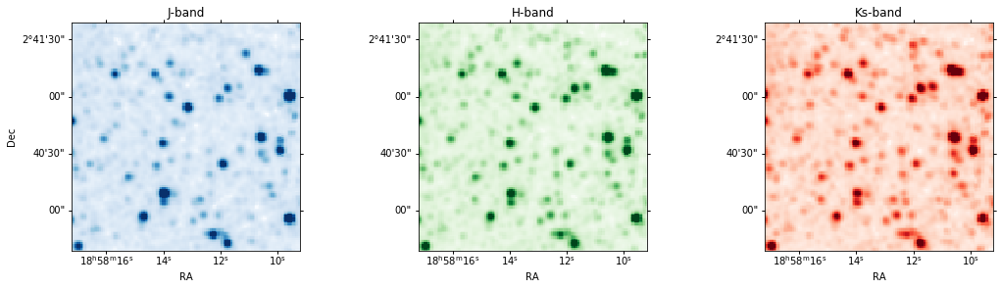

AGAL037.554+00.201


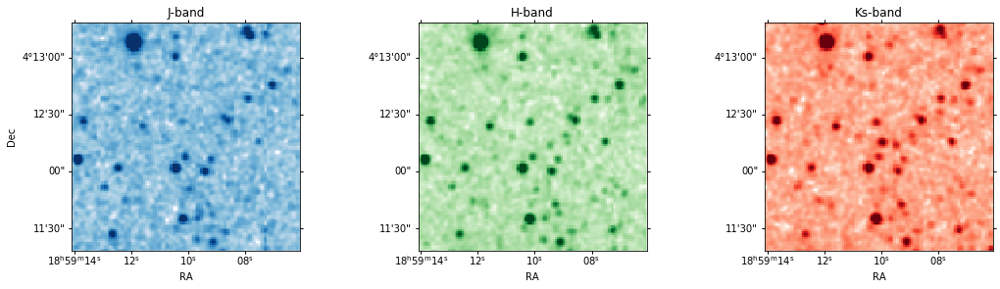

AGAL043.166+00.011


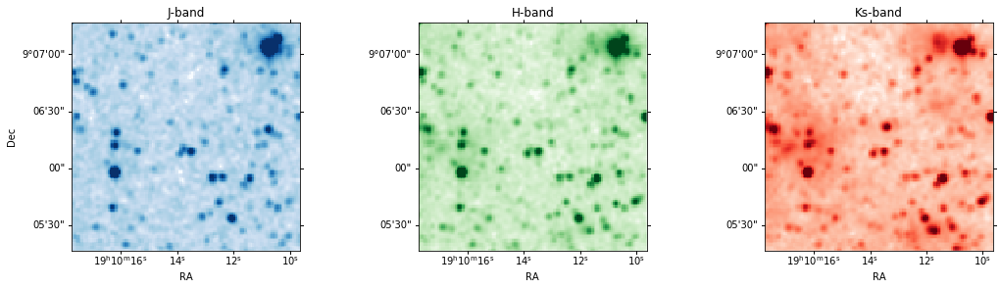

AGAL049.489-00.389


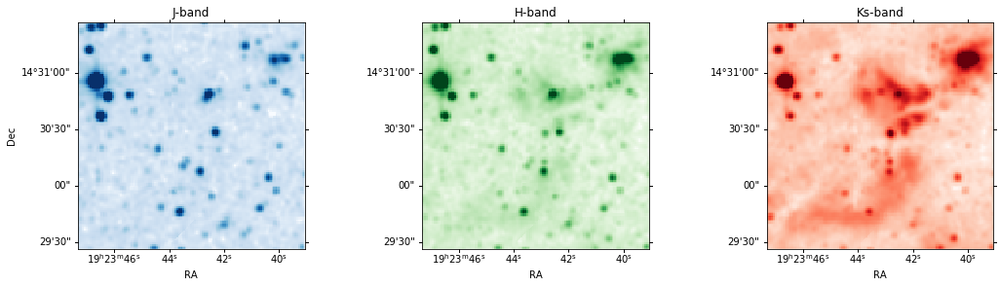

AGAL053.141+00.069


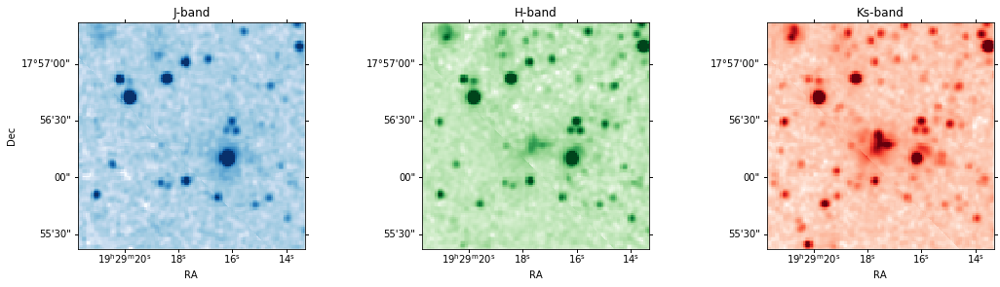

AGAL059.782+00.066


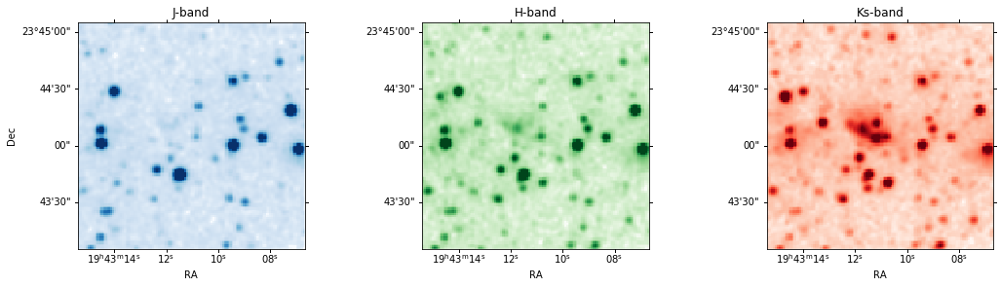

AGAL301.136-00.226


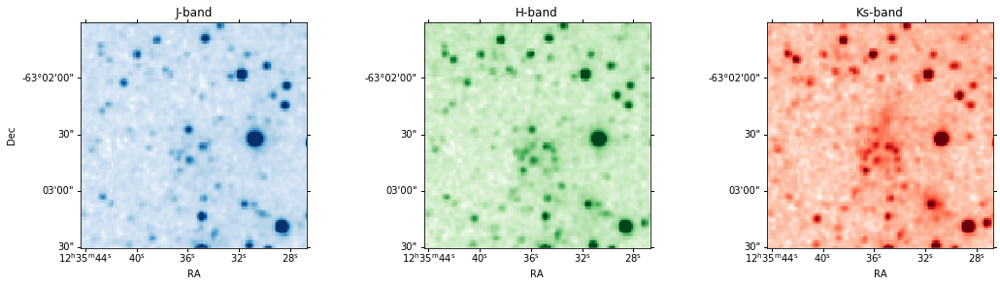

AGAL305.192-00.006


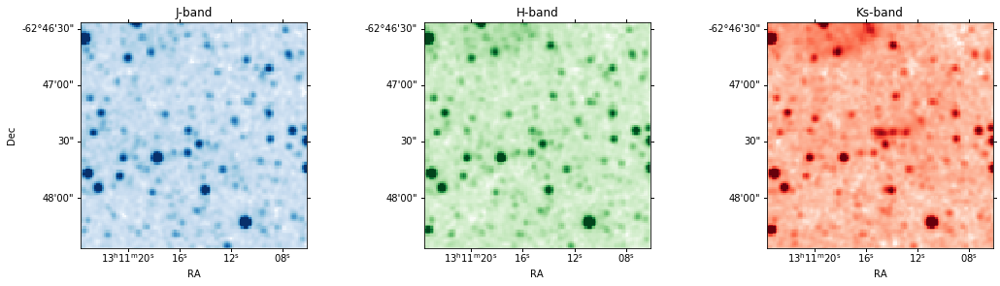

AGAL305.209+00.206


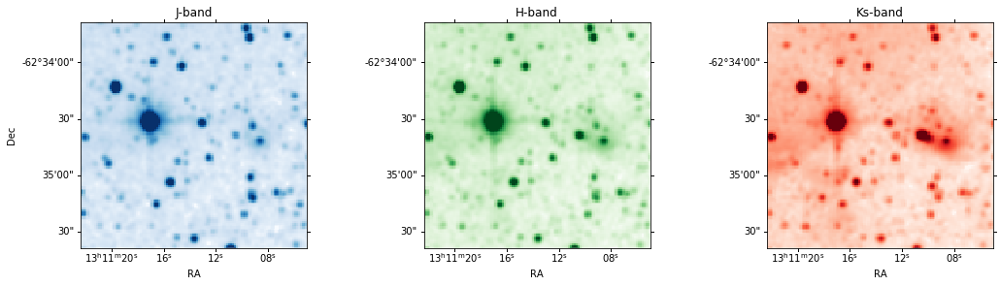

AGAL305.562+00.014


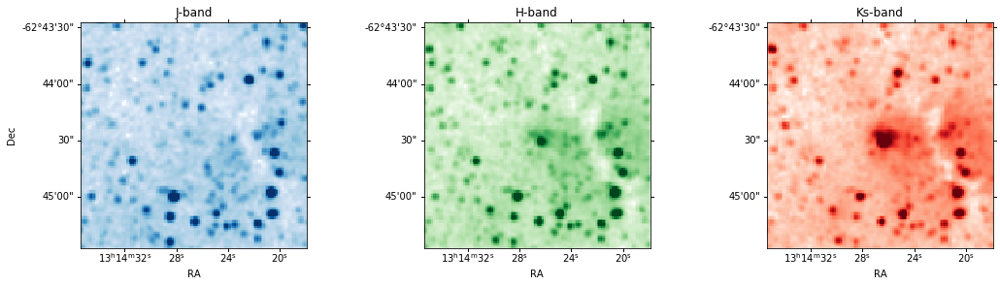

AGAL305.794-00.096


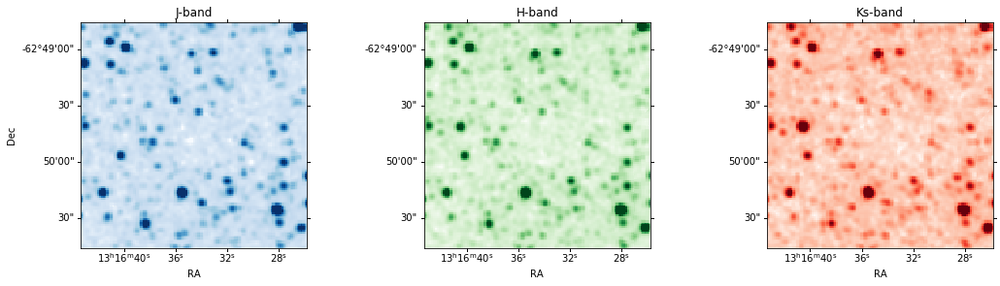

AGAL309.384-00.134


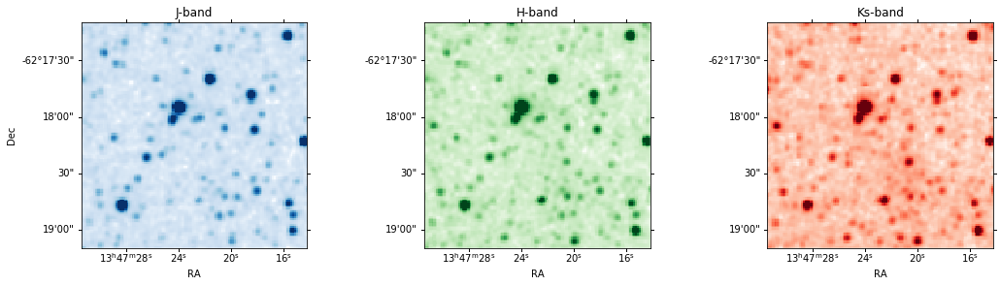

AGAL310.014+00.387


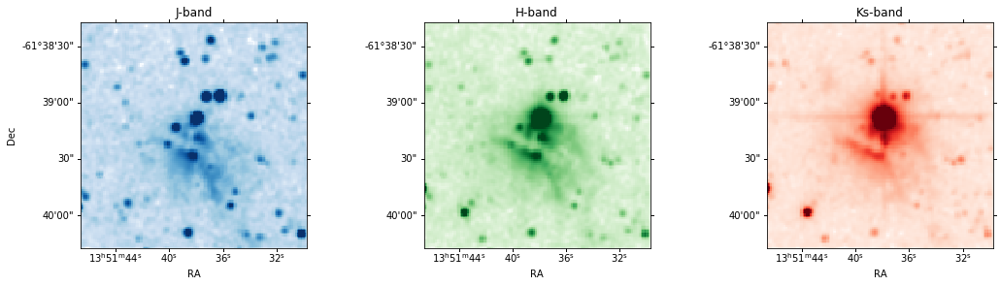

AGAL313.576+00.324


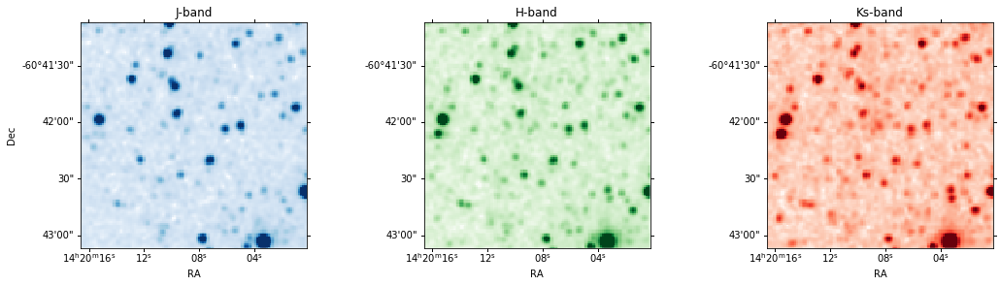

AGAL316.641-00.087


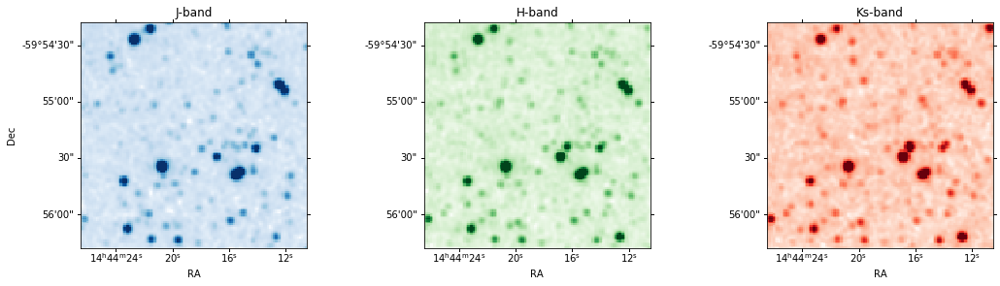

AGAL317.867-00.151


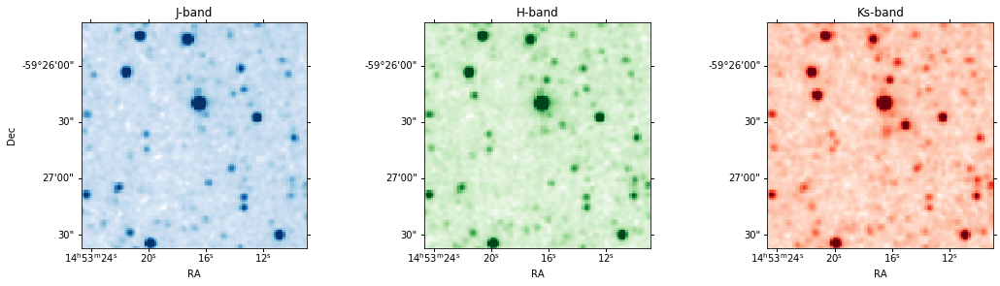

AGAL318.779-00.137


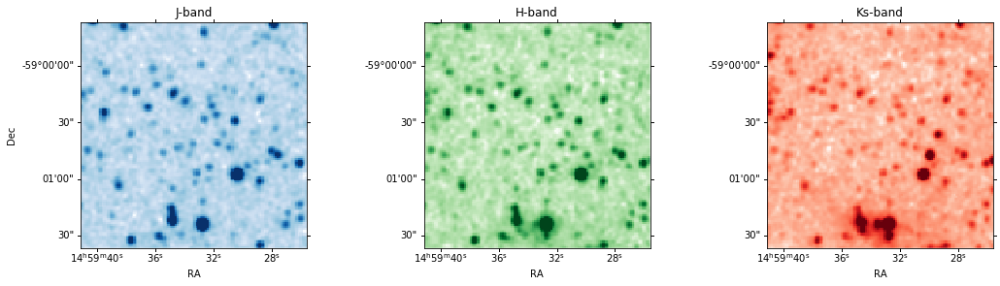

AGAL320.881-00.397


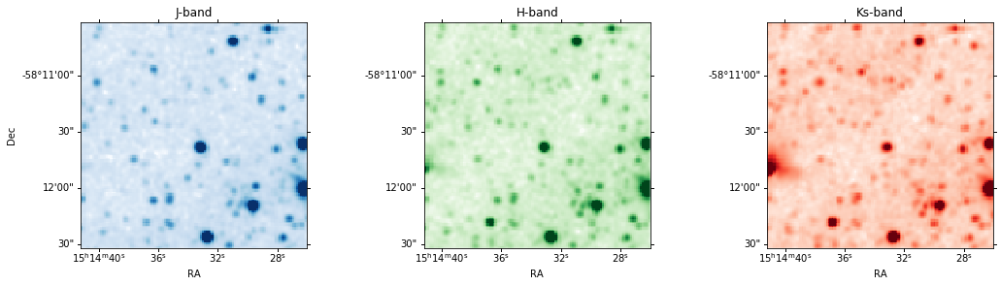

AGAL326.661+00.519


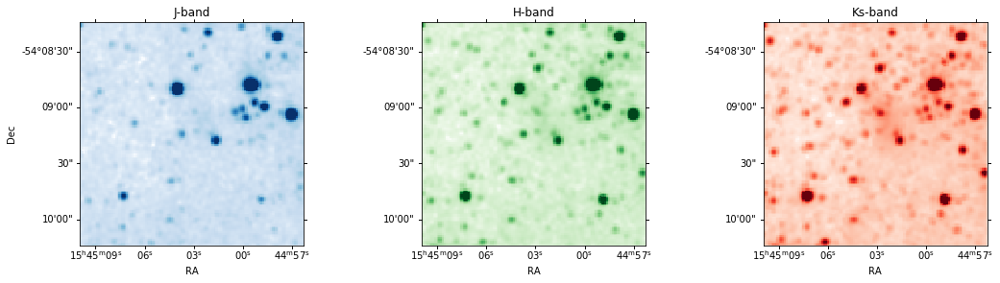

AGAL326.987-00.032


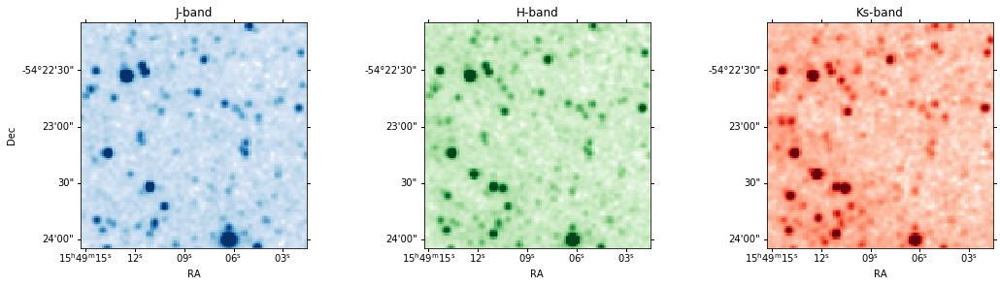

AGAL327.119+00.509


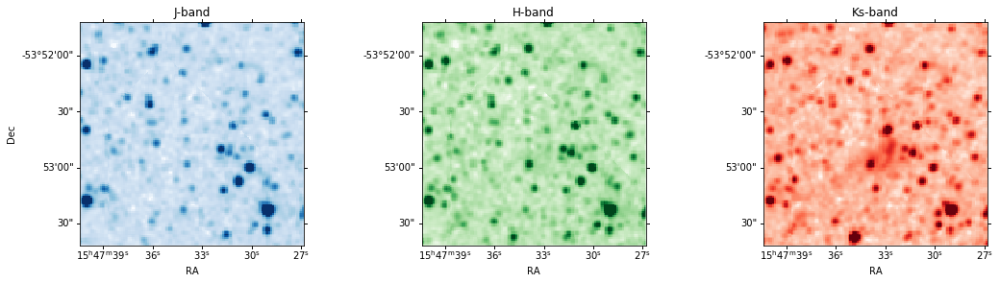

AGAL327.393+00.199


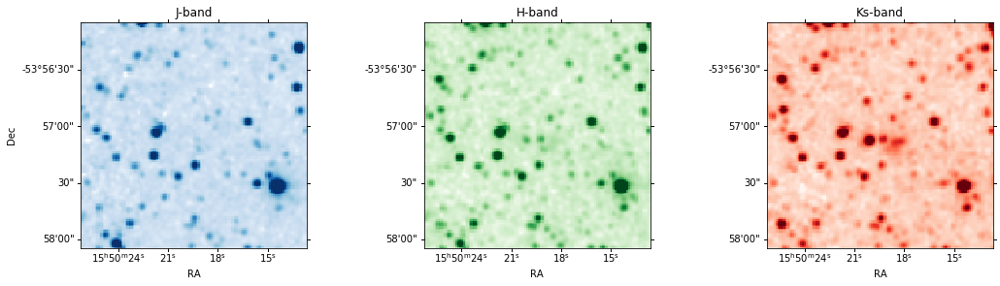

AGAL329.029-00.206


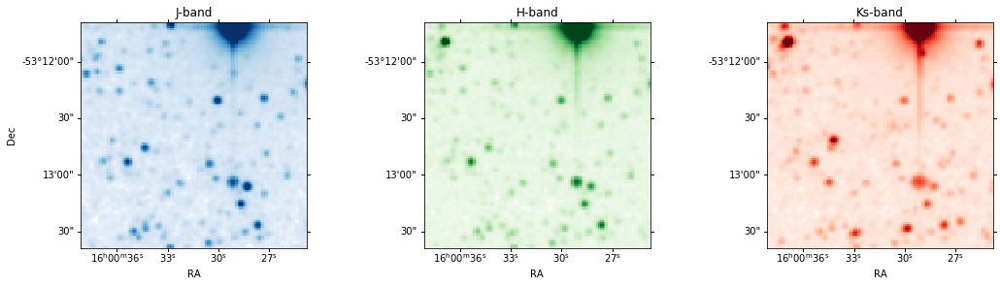

AGAL329.066-00.307


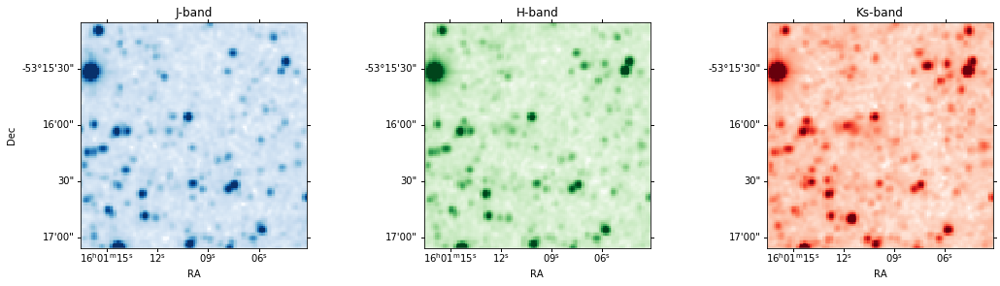

AGAL330.879-00.367


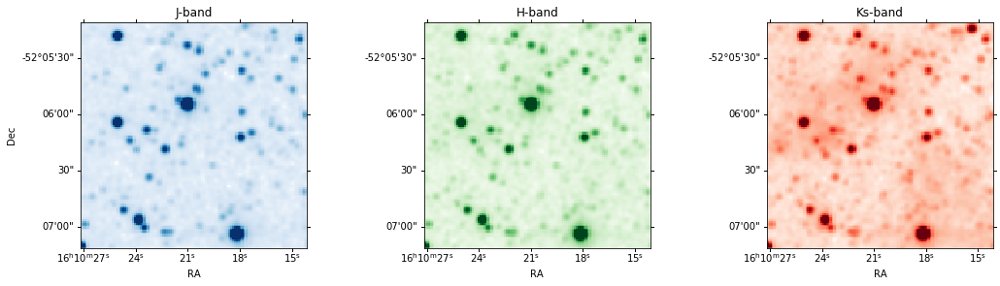

AGAL330.954-00.182


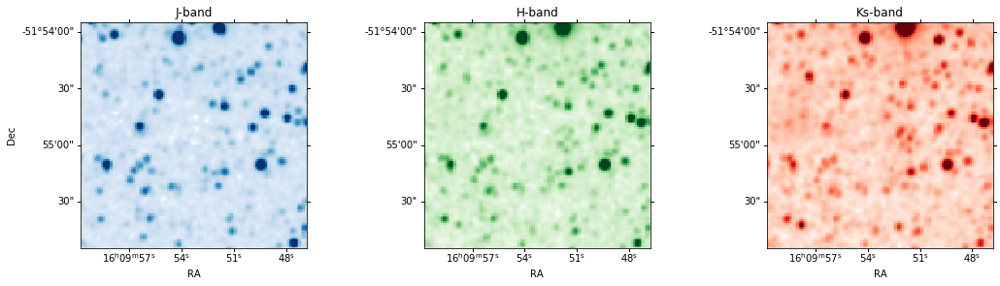

AGAL331.709+00.582


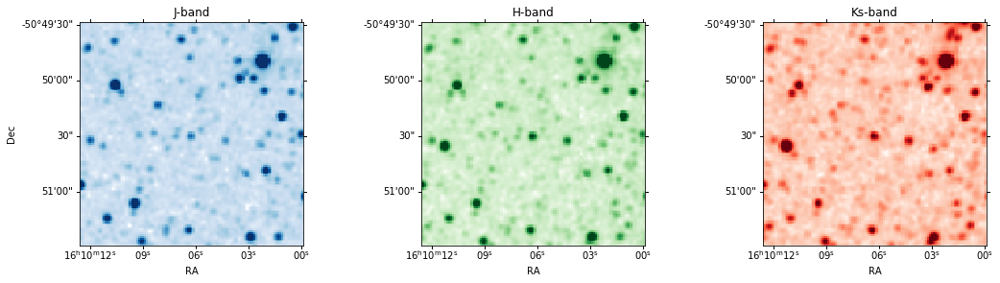

AGAL332.094-00.421


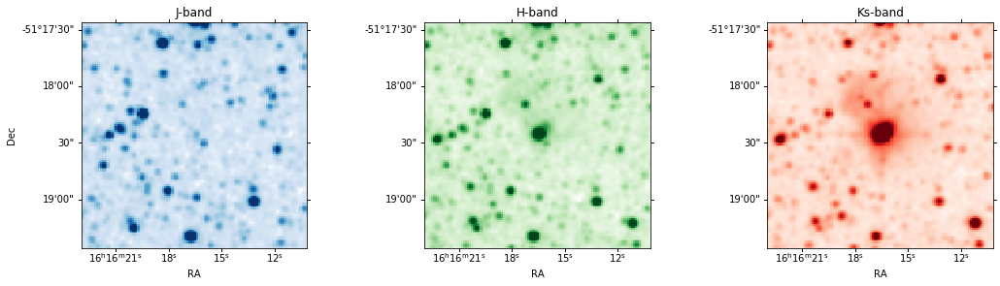

AGAL332.826-00.549


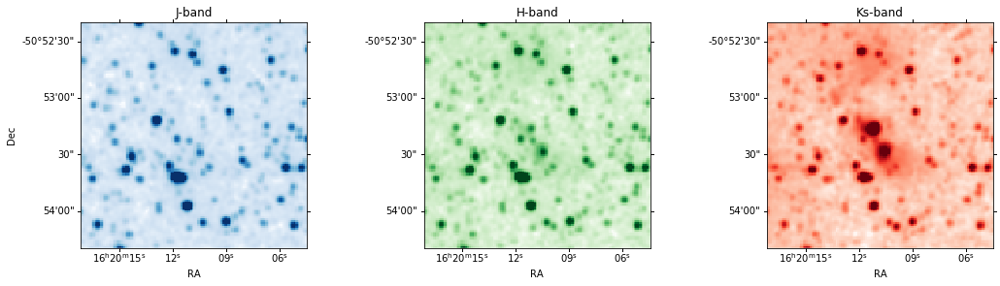

AGAL333.134-00.431


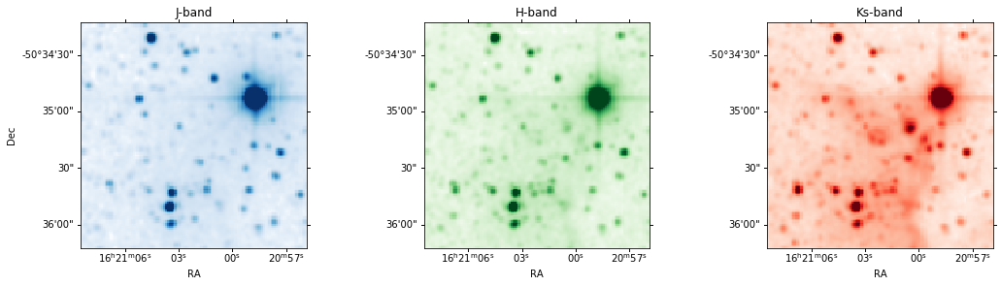

AGAL333.284-00.387


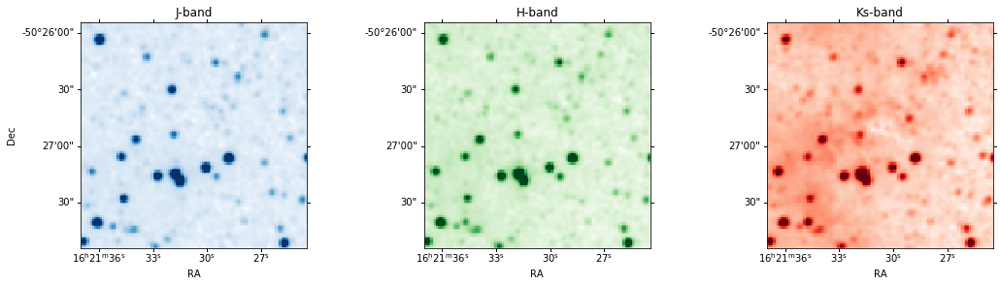

AGAL333.314+00.106


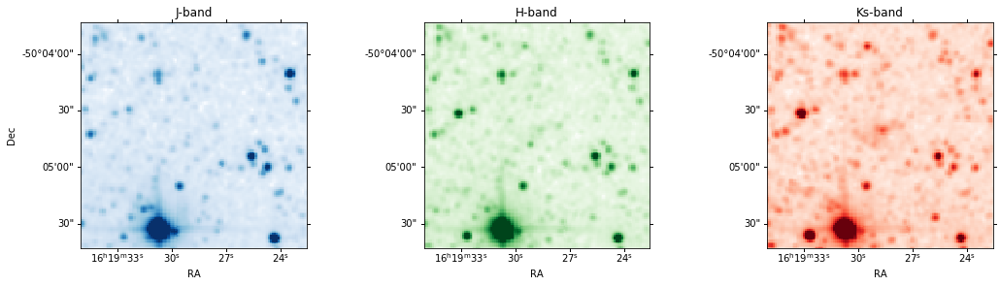

AGAL333.604-00.212


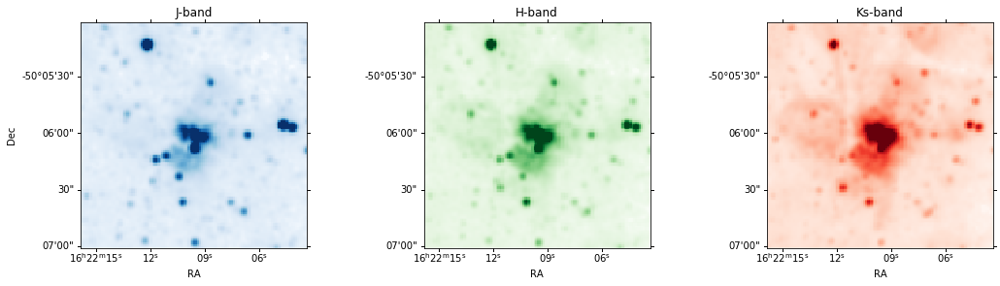

AGAL333.656+00.059


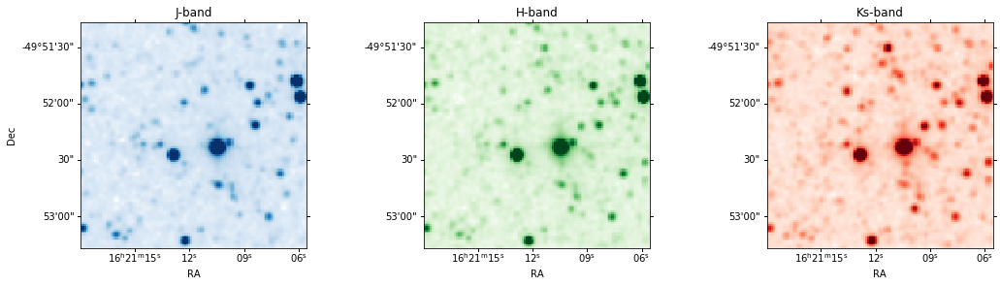

AGAL335.789+00.174


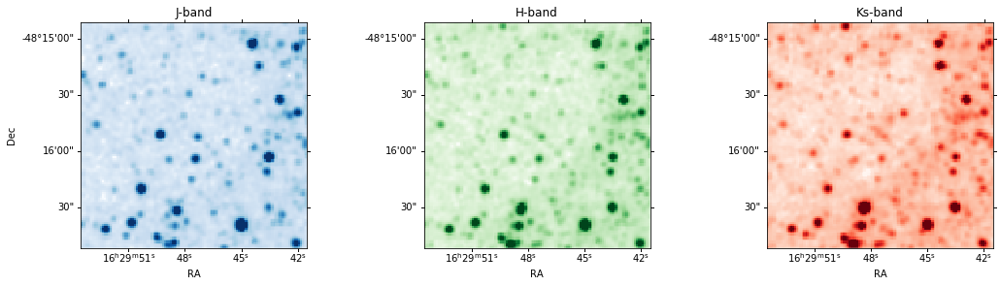

AGAL336.958-00.224


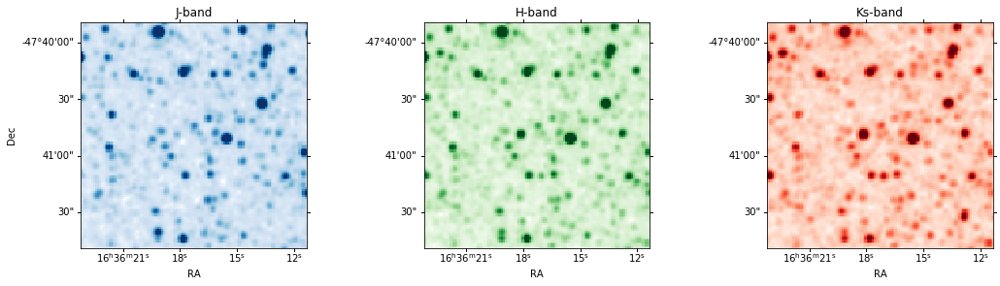

AGAL337.176-00.032


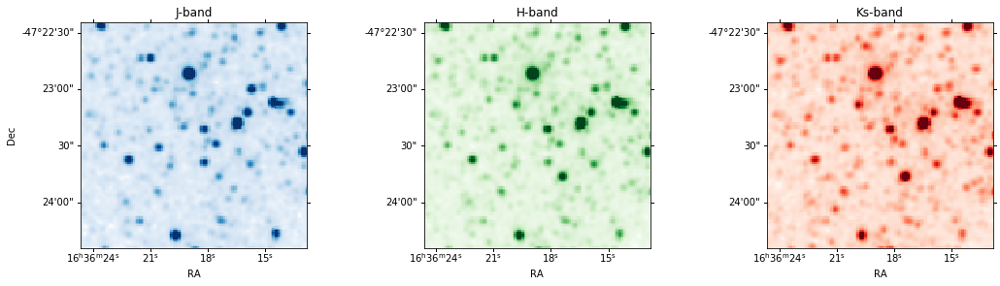

AGAL337.258-00.101


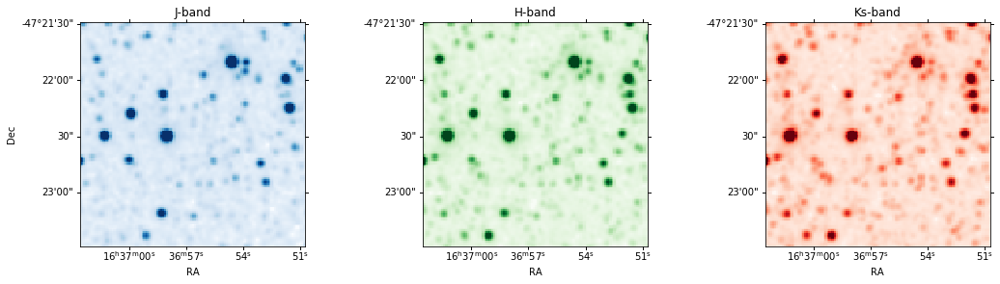

AGAL337.286+00.007


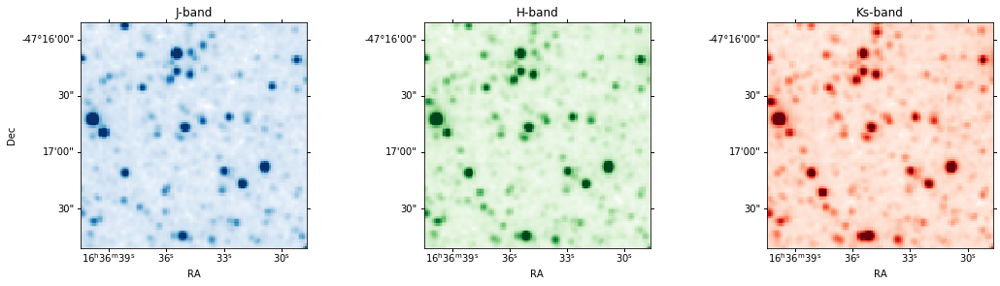

AGAL337.406-00.402


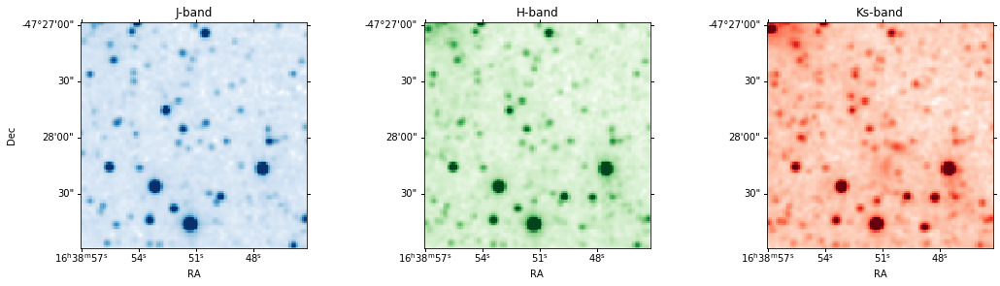

AGAL337.704-00.054


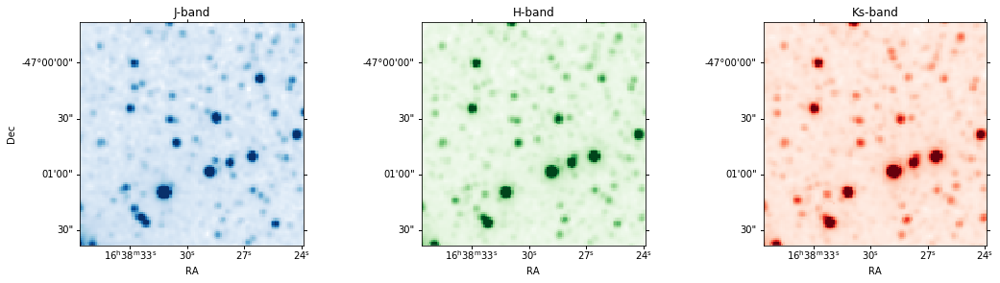

AGAL337.916-00.477


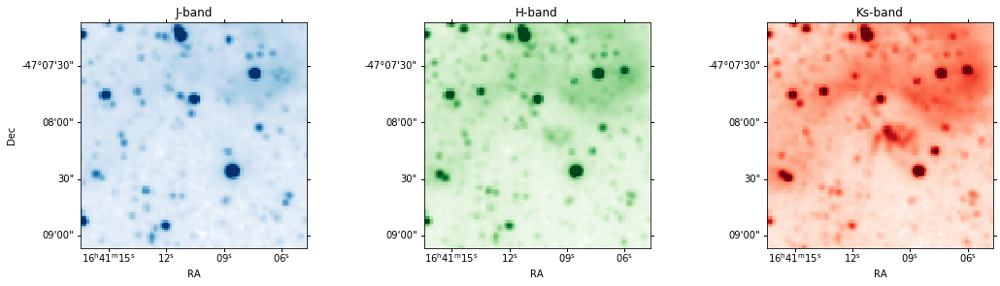

AGAL338.066+00.044


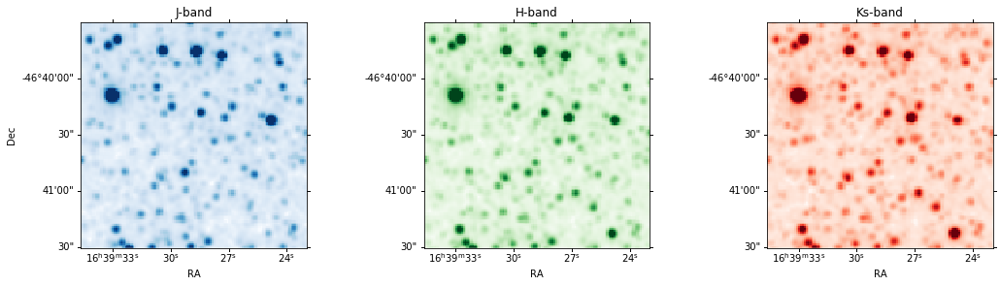

AGAL338.786+00.476


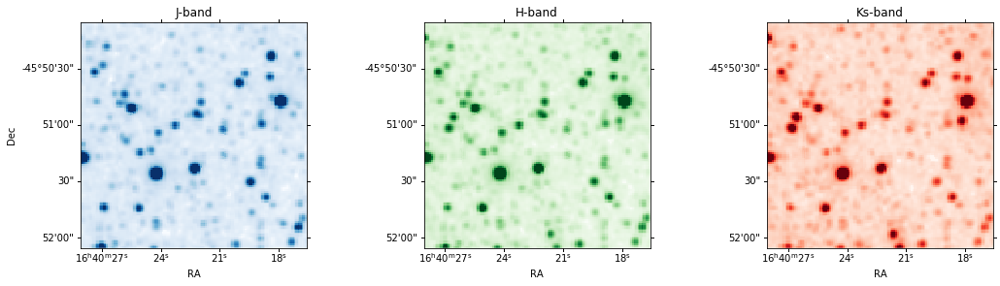

AGAL338.926+00.554


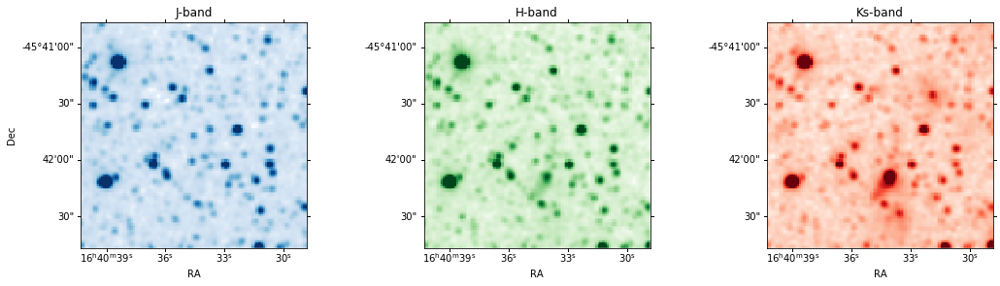

AGAL339.623-00.122


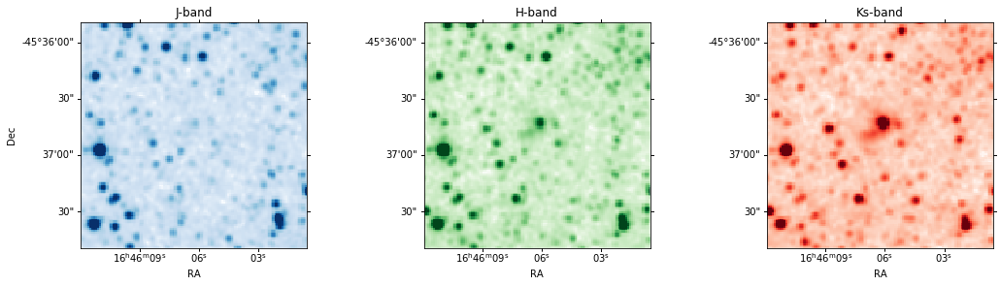

AGAL340.374-00.391


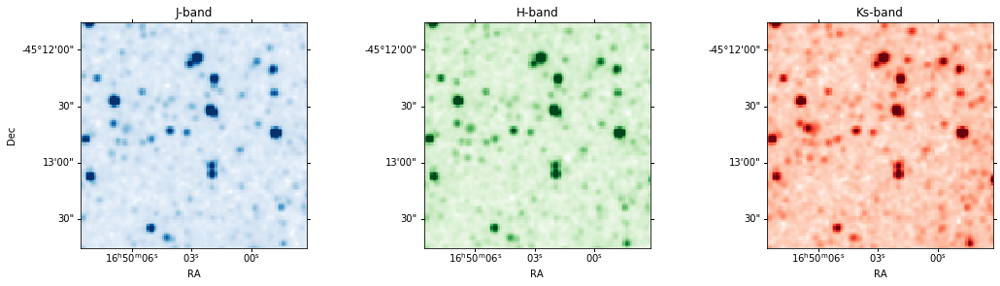

AGAL340.746-01.001


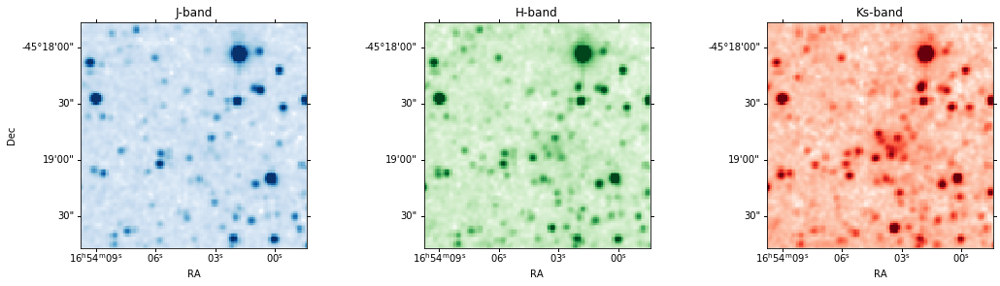

AGAL340.784-00.097


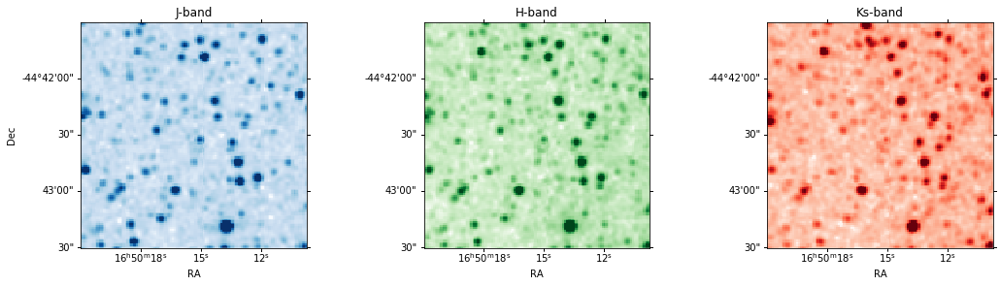

AGAL341.217-00.212


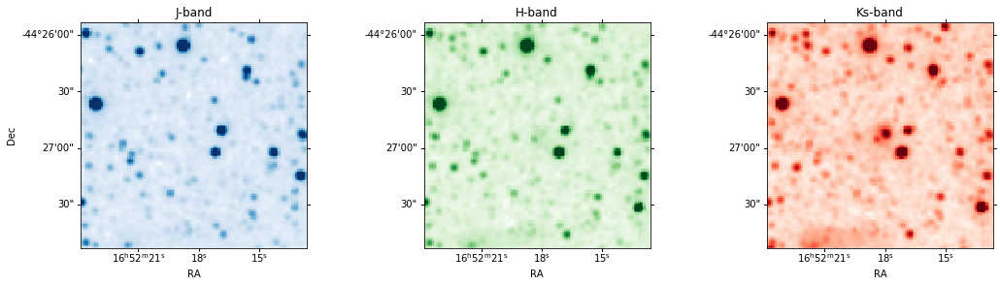

AGAL342.484+00.182


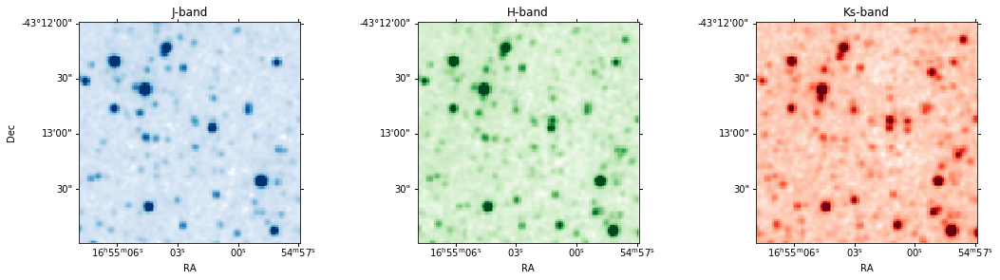

AGAL343.128-00.062


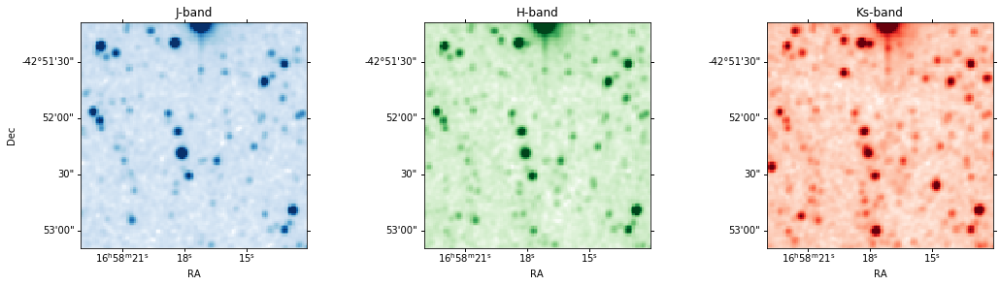

AGAL343.756-00.164


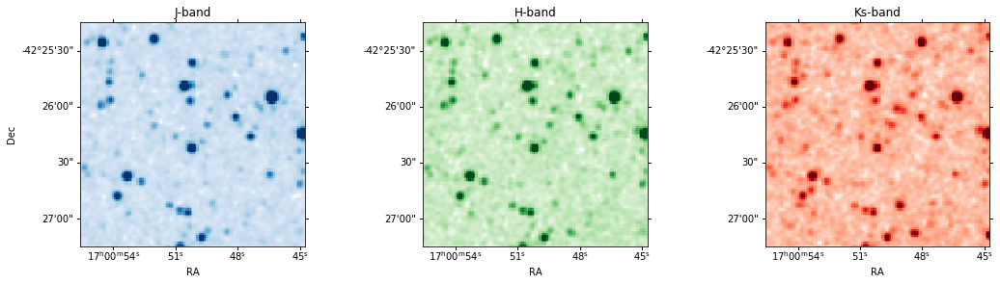

AGAL344.227-00.569


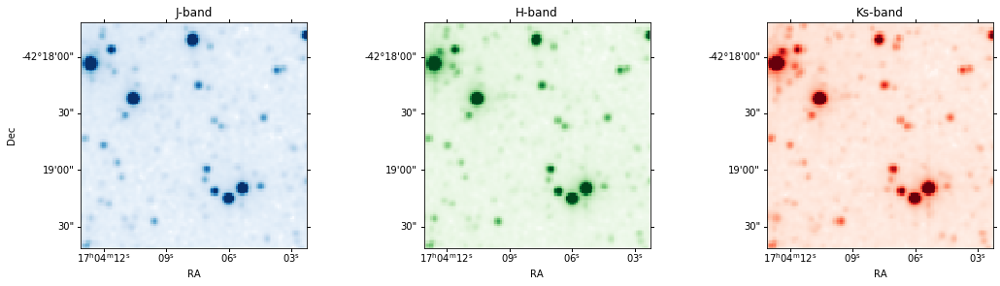

AGAL345.003-00.224


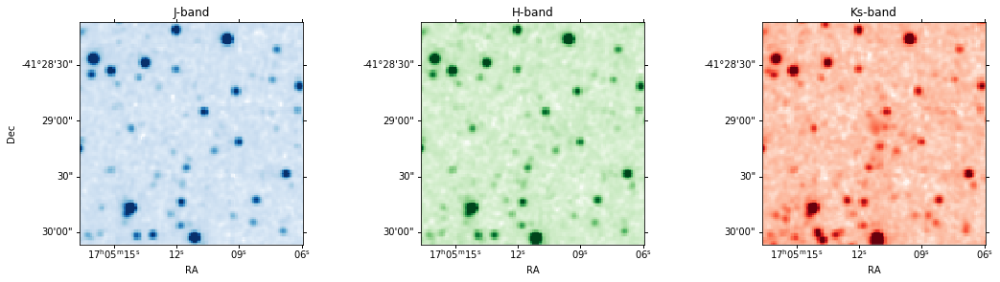

AGAL345.488+00.314


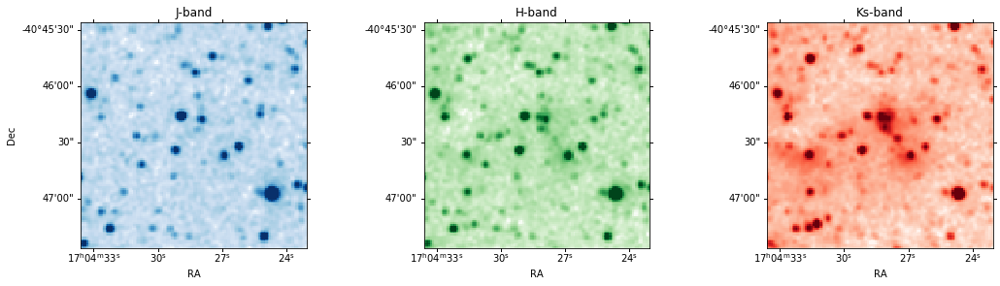

AGAL345.504+00.347


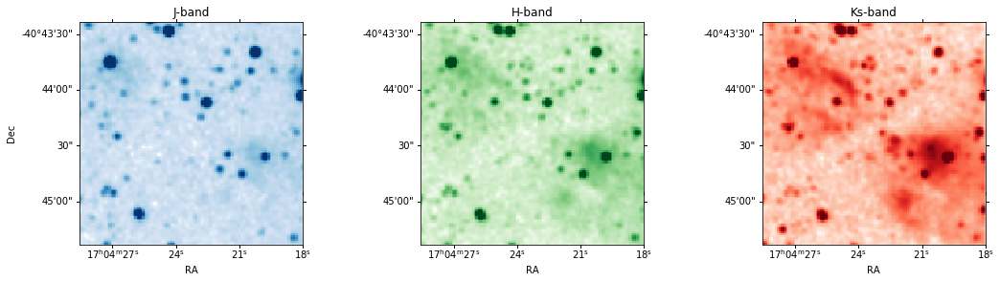

AGAL345.718+00.817


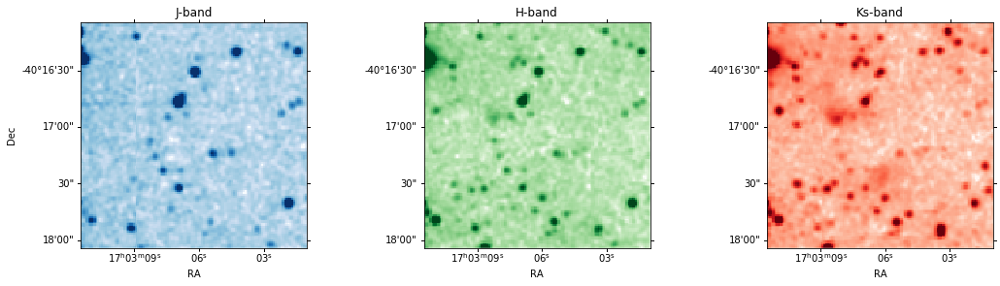

AGAL351.131+00.771


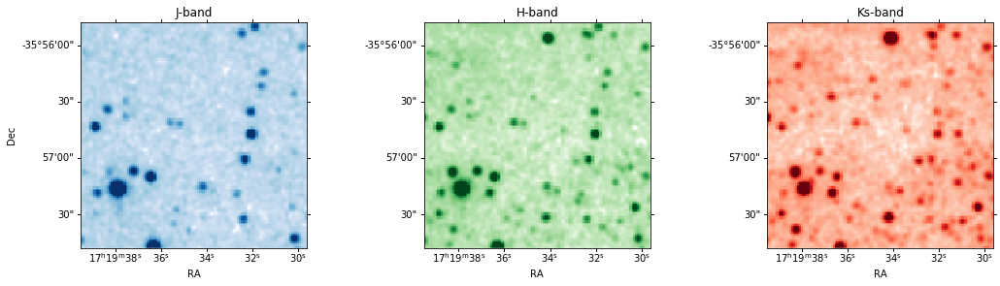

AGAL351.161+00.697


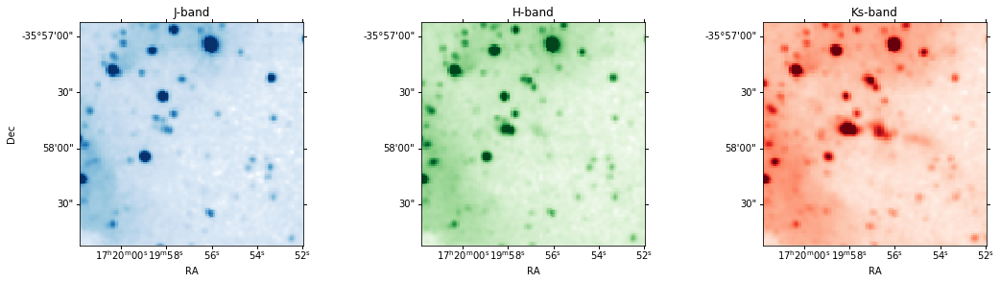

AGAL351.244+00.669


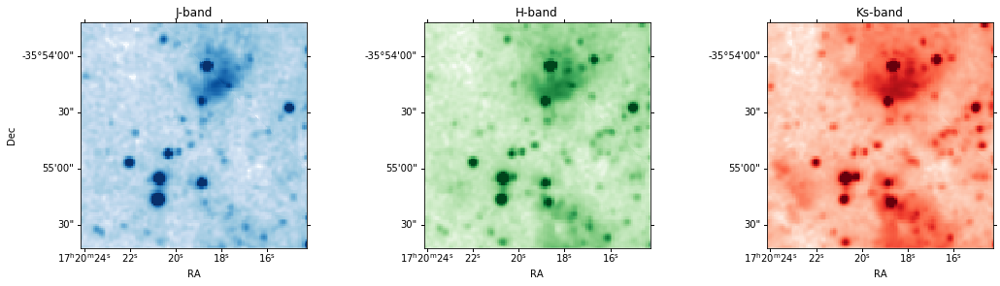

AGAL351.416+00.646


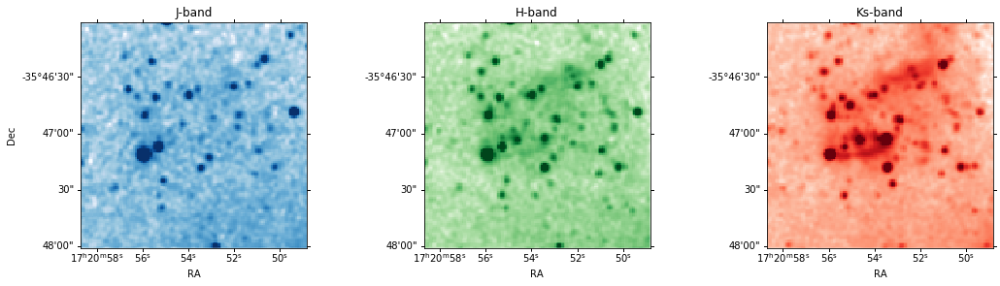

AGAL351.444+00.659


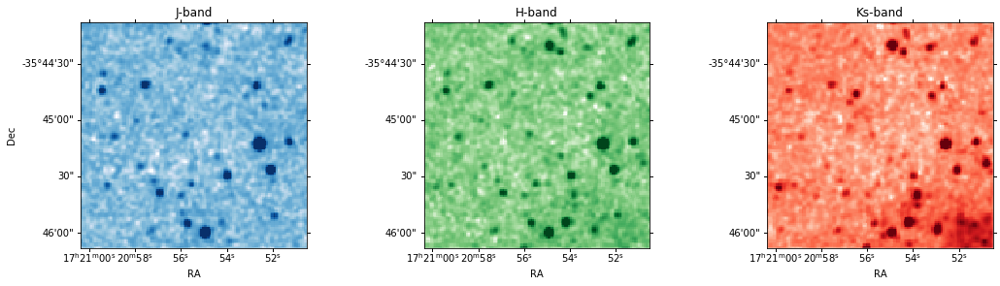

AGAL351.571+00.762


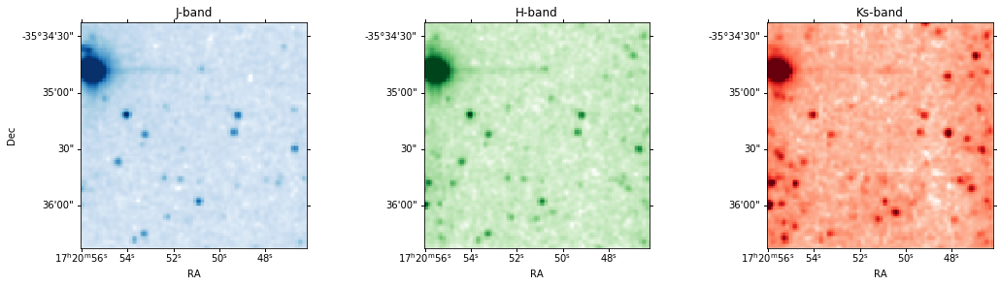

AGAL351.581-00.352


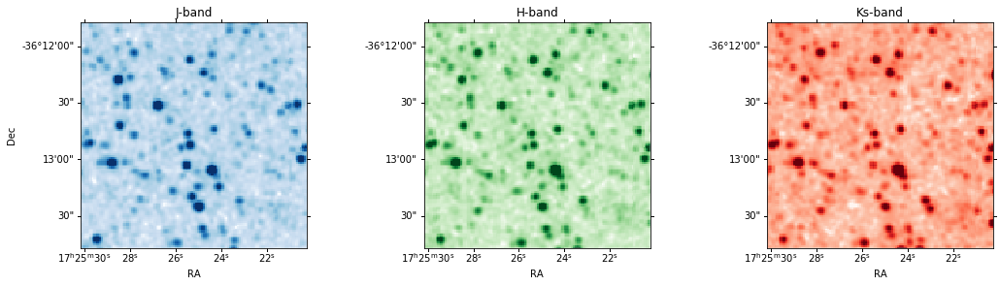

AGAL351.774-00.537


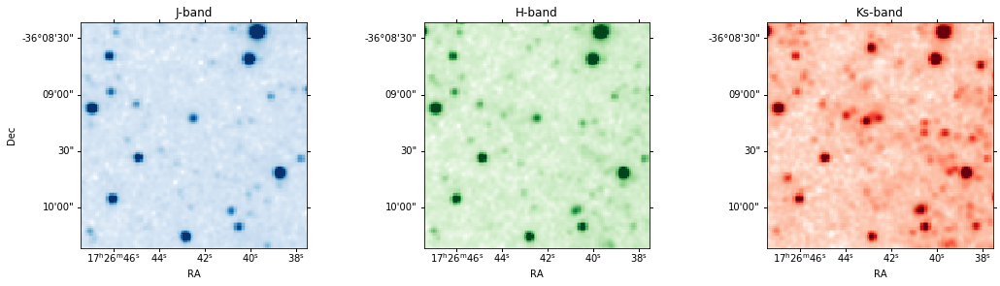

AGAL353.066+00.452


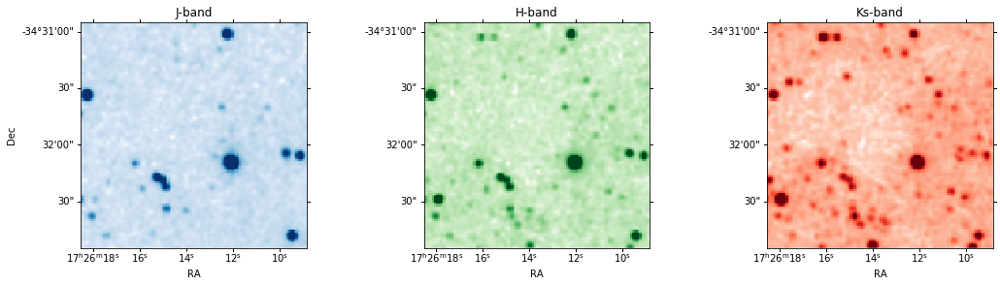

AGAL353.417-00.079


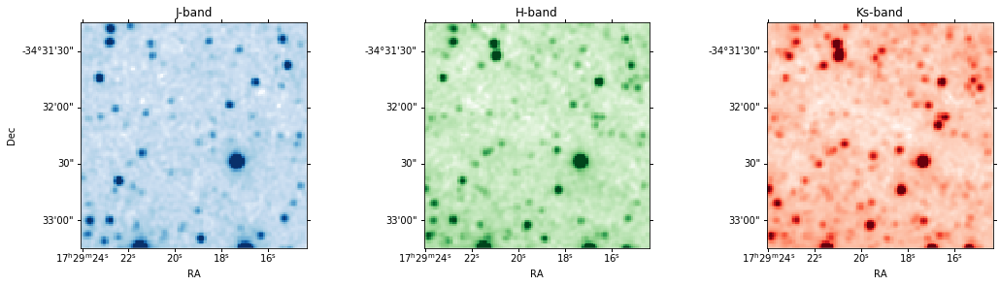

AGAL354.944-00.537


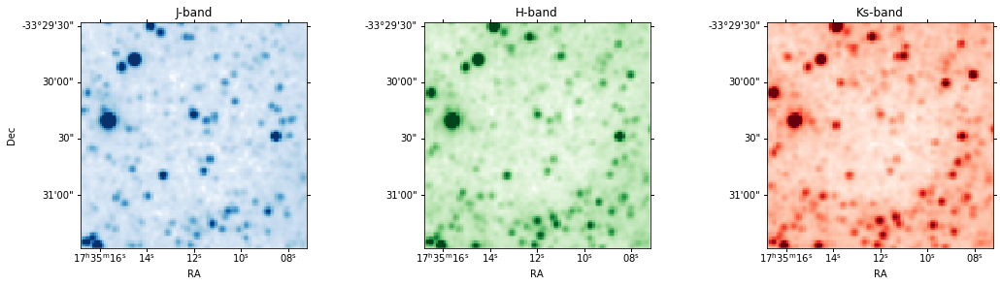

In [218]:
# convert coordinates
ra_hms =[]
for ra in data['RAJ2000']:
    ra_hms.append(ra.replace(' ',':'))
    
de_dms =[]
for de in data['DEJ2000']:
    de_dms.append(de.replace(' ',':'))
#de_dms

pos = coords.SkyCoord(ra_hms, de_dms, frame='icrs', unit=(u.hourangle,u.deg))
for index, csc in enumerate(data['CSC']):
    #print(index,csc,ra_hms[index], de_dms[index],pos[index])
    #print(index,csc,pos.ra[index])
    print(csc)
    query_2mass(pos.ra[index], pos.dec[index], 2.0, output='C:/Users/navar/Downloads/top100_2mass/sqrt/'+csc+'.png', minmax=[0.001,0.99], sqrt=True)
#    query_2mass(ra_hms[index], de_dms[index], 4.0, output='C:/Users/navar/Downloads/top100_2mass/'+csc+'.png')

AGAL008.684-00.367


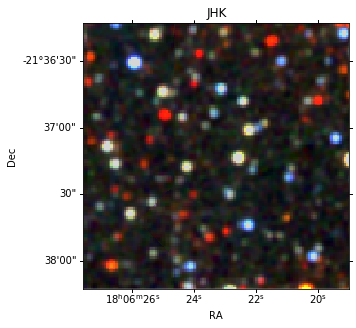

AGAL008.706-00.414


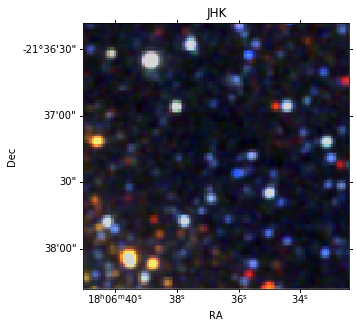

AGAL010.444-00.017


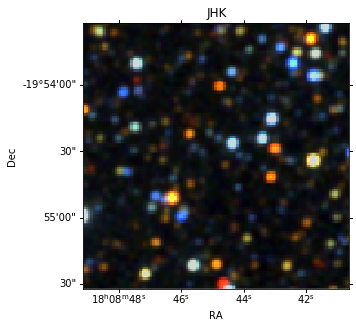

AGAL010.472+00.027


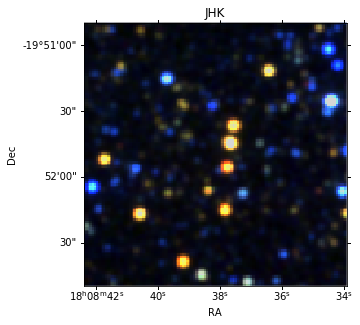

AGAL010.624-00.384


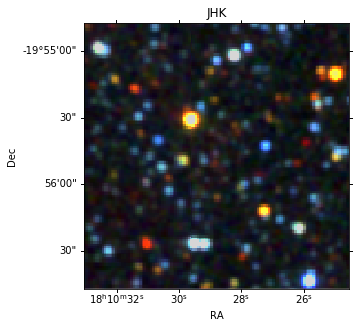

AGAL012.804-00.199


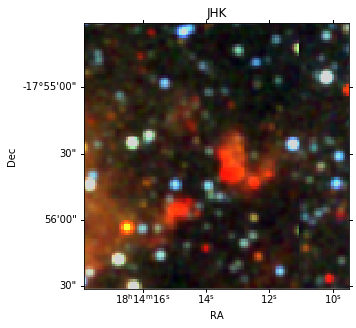

AGAL013.178+00.059


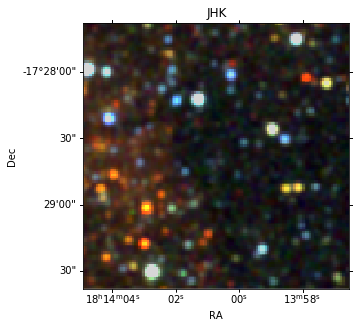

AGAL013.658-00.599


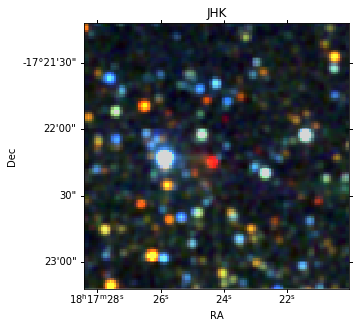

AGAL014.114-00.574


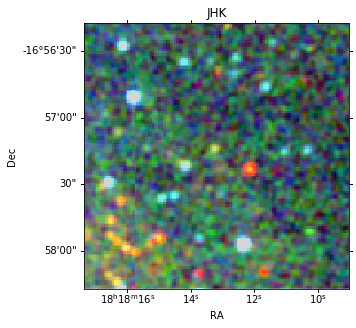

AGAL014.194-00.194


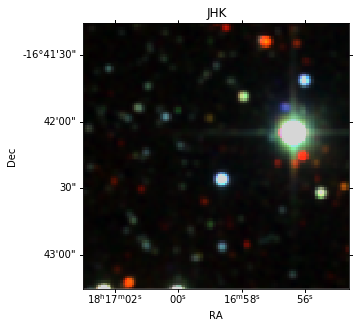

AGAL014.492-00.139


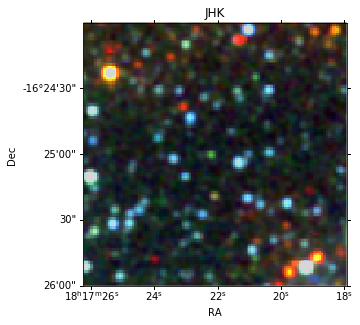

AGAL014.632-00.577


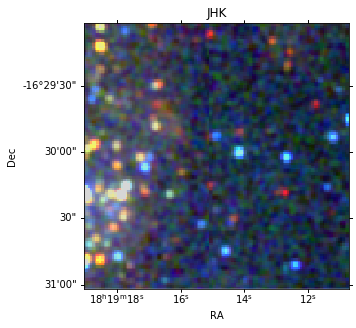

AGAL015.029-00.669


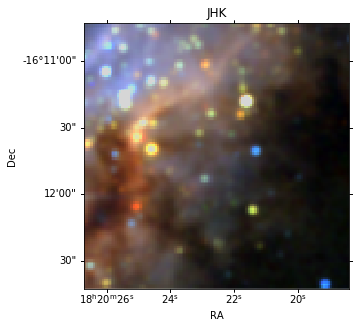

AGAL018.606-00.074


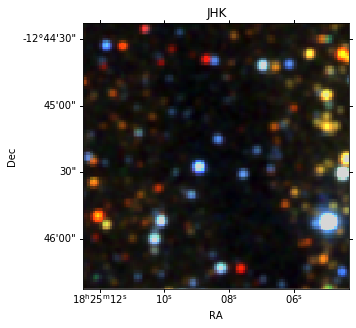

AGAL018.734-00.226


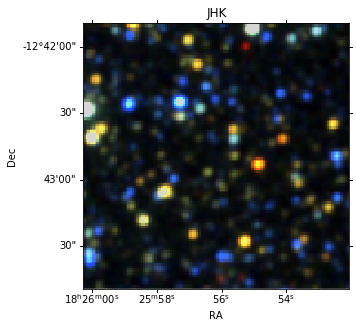

AGAL018.888-00.474


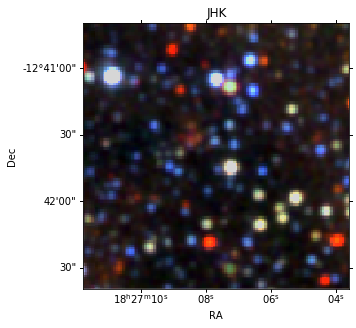

AGAL019.882-00.534


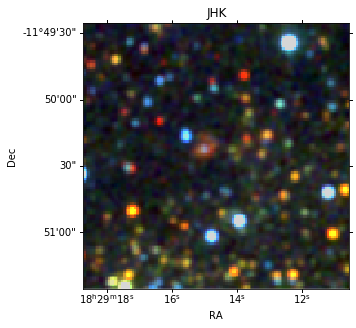

AGAL022.376+00.447


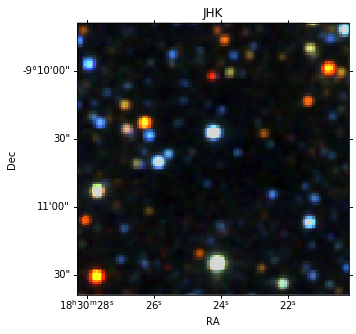

AGAL023.206-00.377


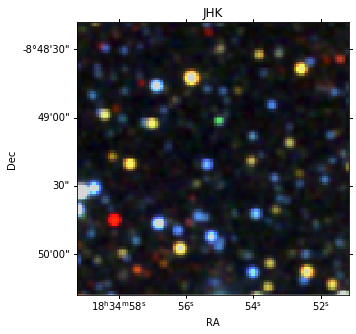

AGAL024.629+00.172


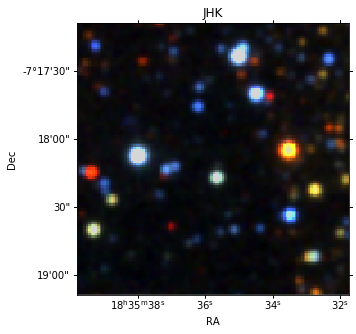

AGAL028.564-00.236


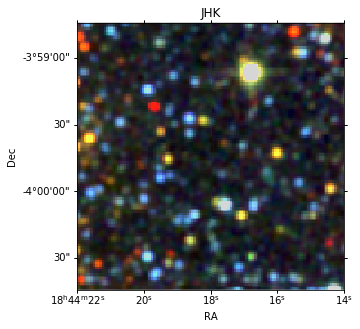

AGAL028.861+00.066


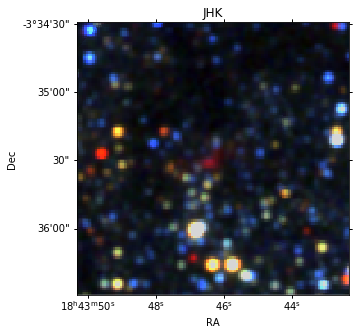

AGAL030.818-00.056


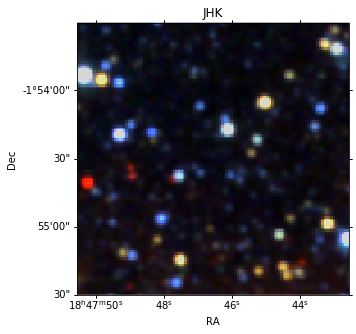

AGAL030.848-00.081


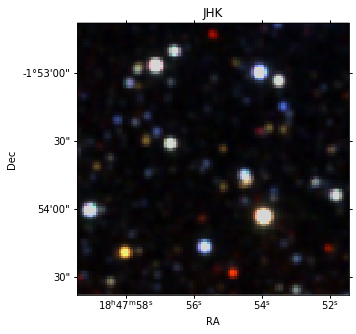

AGAL030.893+00.139


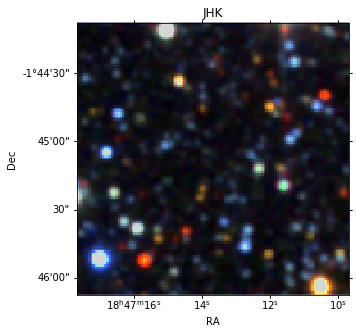

AGAL031.412+00.307


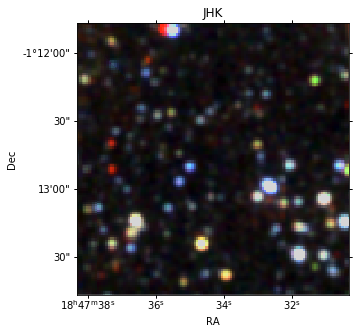

AGAL034.258+00.154


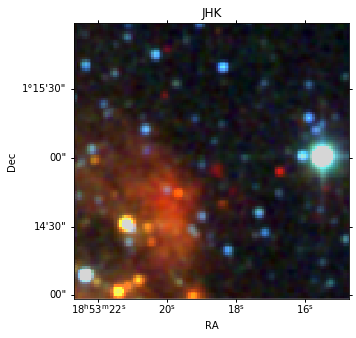

AGAL034.401+00.226


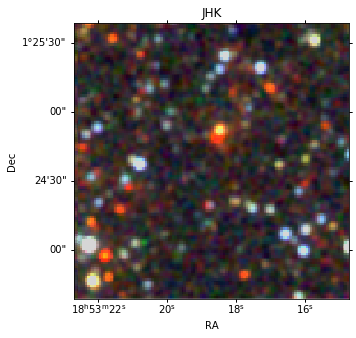

AGAL034.411+00.234


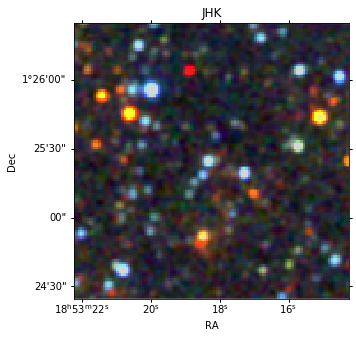

AGAL034.821+00.351


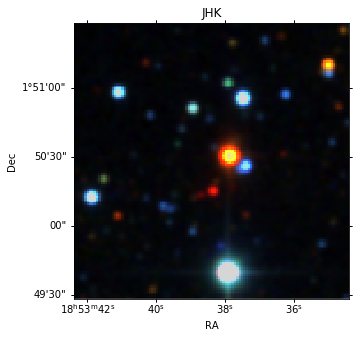

AGAL035.197-00.742


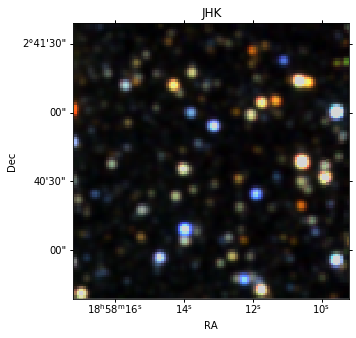

AGAL037.554+00.201


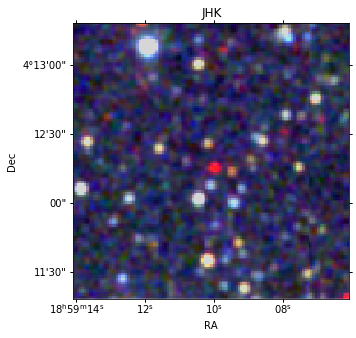

AGAL043.166+00.011


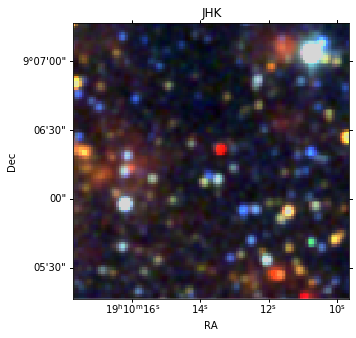

AGAL049.489-00.389


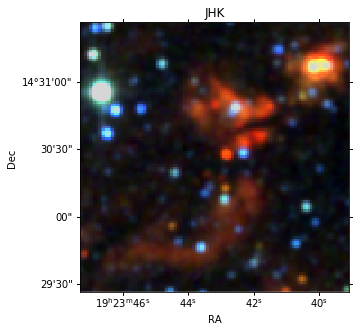

AGAL053.141+00.069


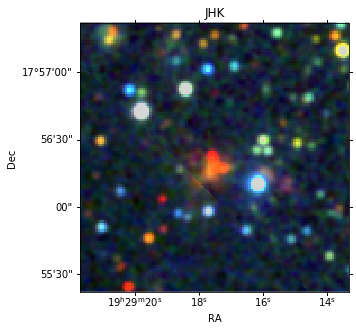

AGAL059.782+00.066


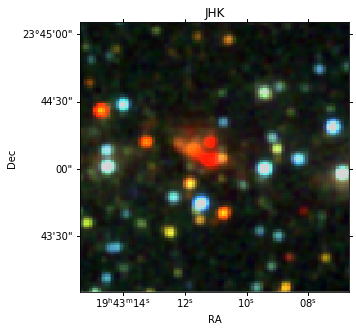

AGAL301.136-00.226


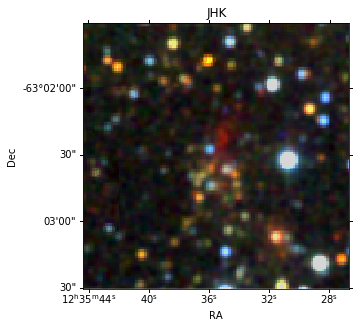

AGAL305.192-00.006


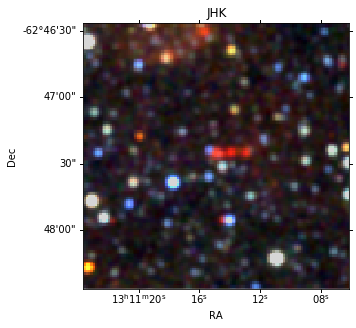

AGAL305.209+00.206


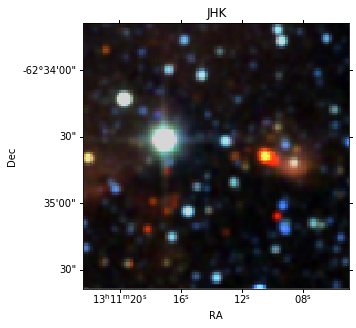

AGAL305.562+00.014


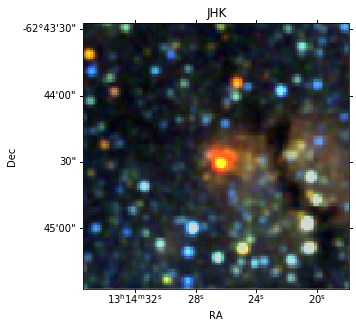

AGAL305.794-00.096


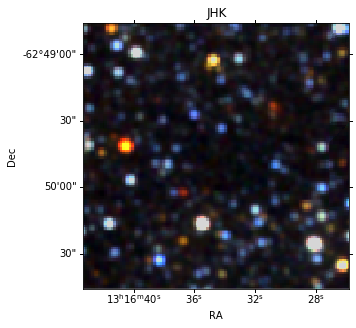

AGAL309.384-00.134


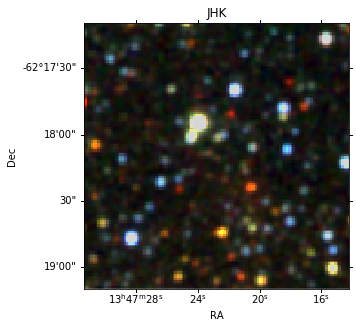

AGAL310.014+00.387


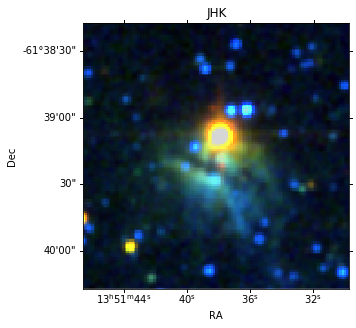

AGAL313.576+00.324


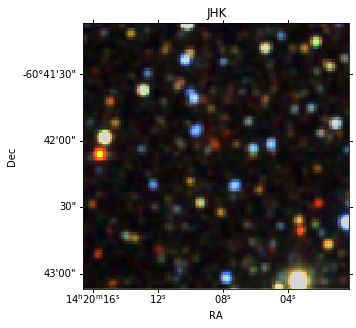

AGAL316.641-00.087


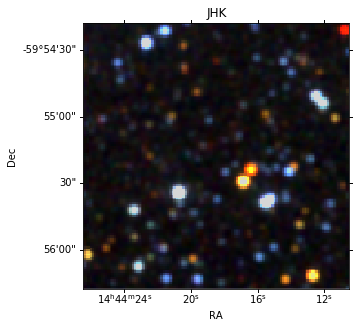

AGAL317.867-00.151


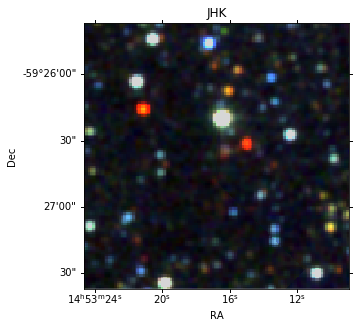

AGAL318.779-00.137


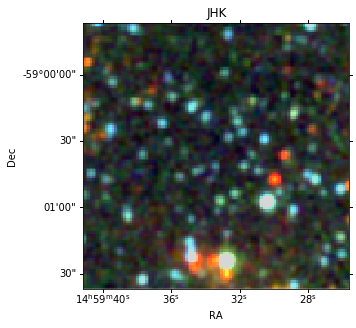

AGAL320.881-00.397


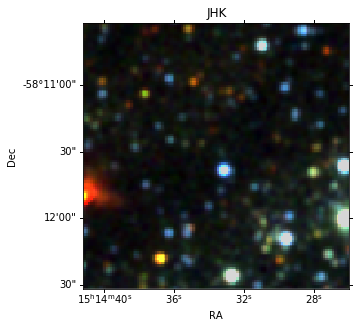

AGAL326.661+00.519


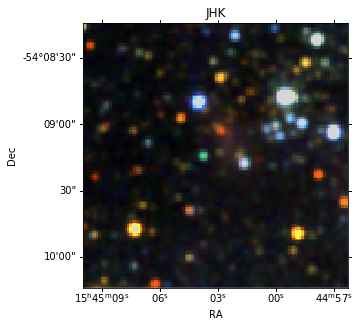

AGAL326.987-00.032


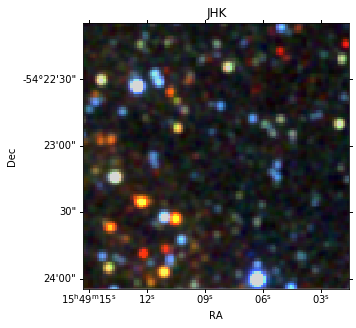

AGAL327.119+00.509


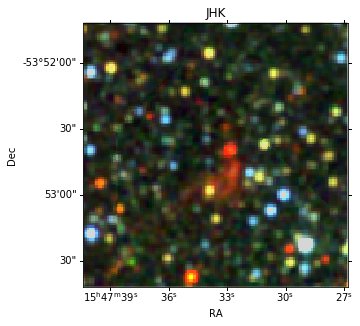

AGAL327.393+00.199


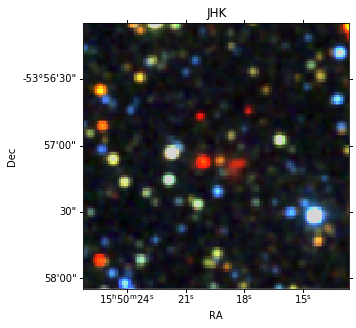

AGAL329.029-00.206


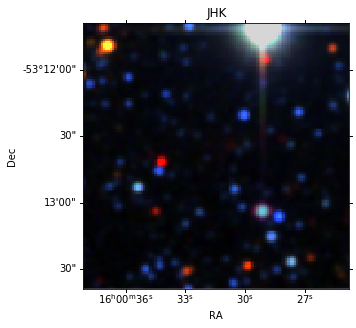

AGAL329.066-00.307


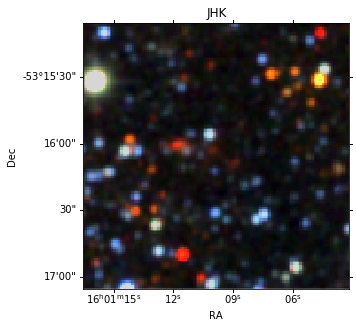

AGAL330.879-00.367


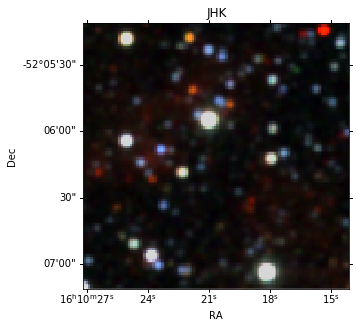

AGAL330.954-00.182


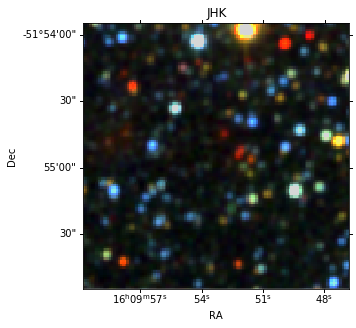

AGAL331.709+00.582


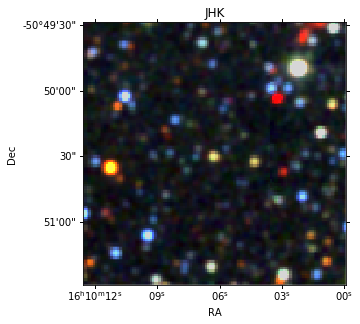

AGAL332.094-00.421


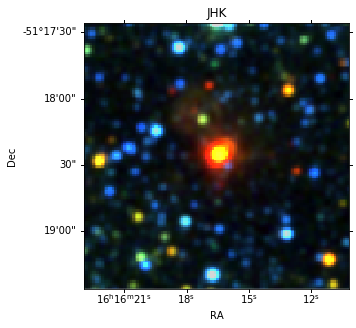

AGAL332.826-00.549


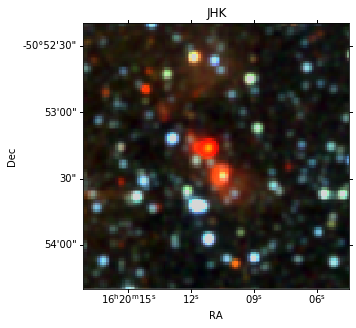

AGAL333.134-00.431


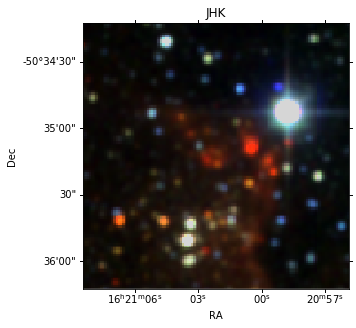

AGAL333.284-00.387


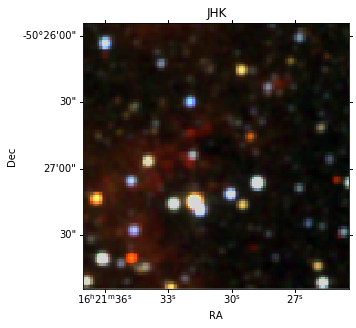

AGAL333.314+00.106


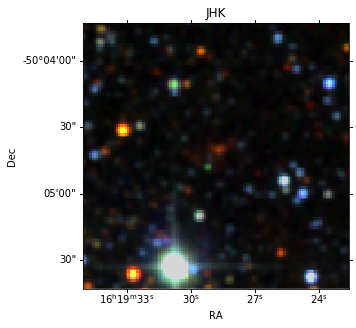

AGAL333.604-00.212


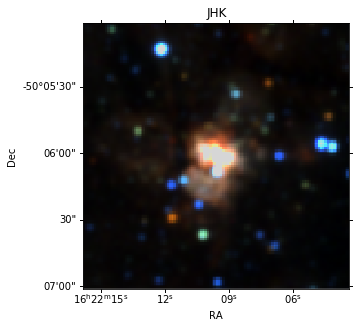

AGAL333.656+00.059


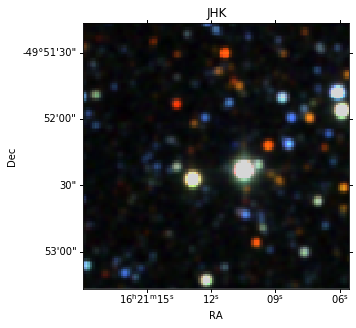

AGAL335.789+00.174


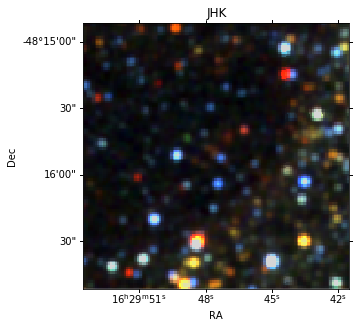

AGAL336.958-00.224


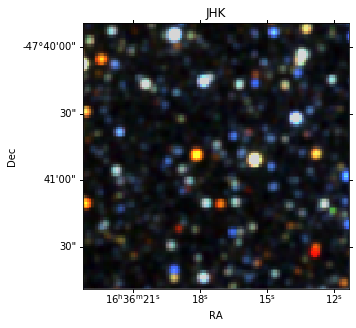

AGAL337.176-00.032


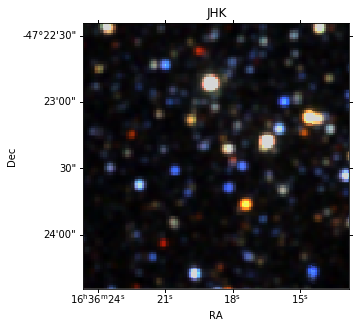

AGAL337.258-00.101


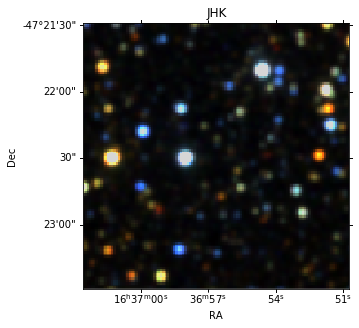

AGAL337.286+00.007


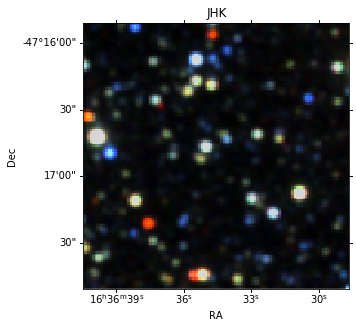

AGAL337.406-00.402


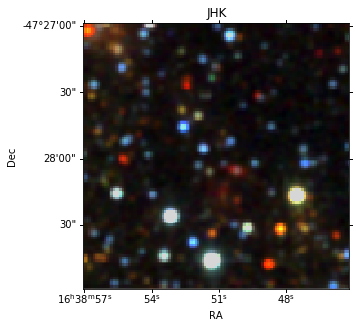

AGAL337.704-00.054


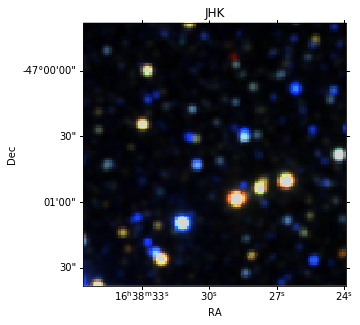

AGAL337.916-00.477


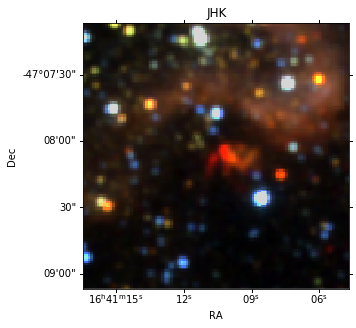

AGAL338.066+00.044


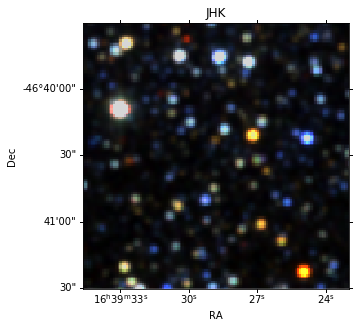

AGAL338.786+00.476


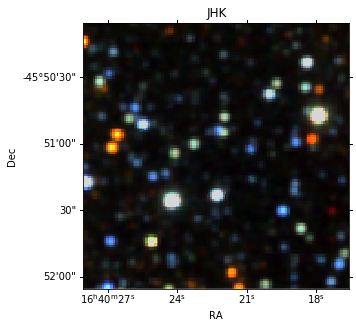

AGAL338.926+00.554


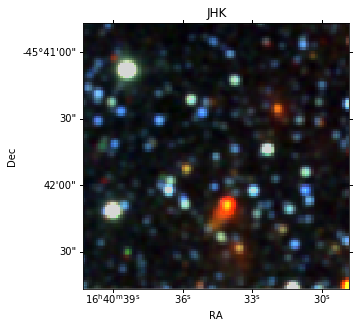

AGAL339.623-00.122


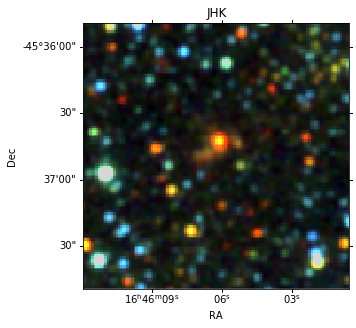

AGAL340.374-00.391


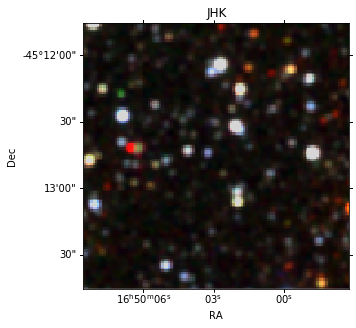

AGAL340.746-01.001


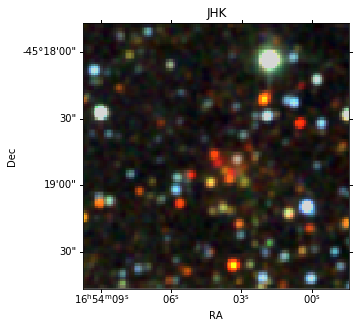

AGAL340.784-00.097


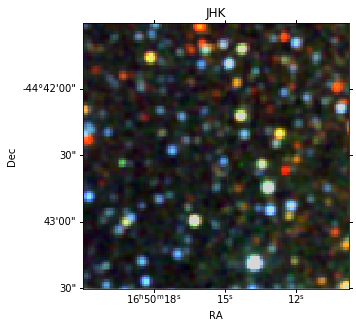

AGAL341.217-00.212


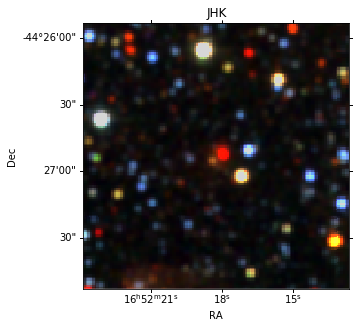

AGAL342.484+00.182


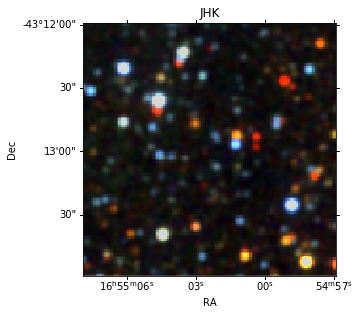

AGAL343.128-00.062


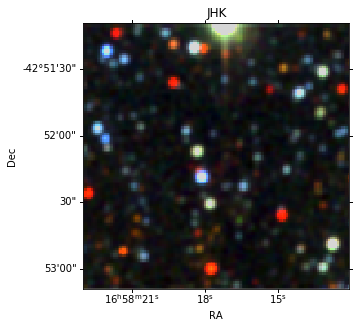

AGAL343.756-00.164


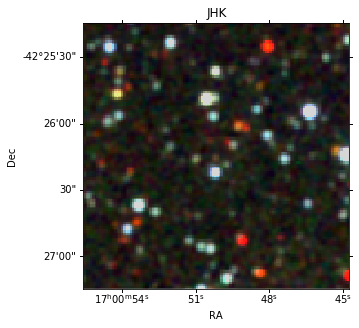

AGAL344.227-00.569


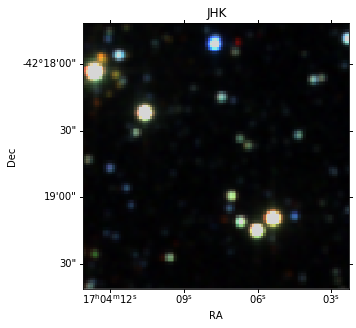

AGAL345.003-00.224


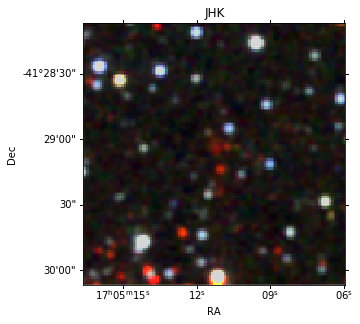

AGAL345.488+00.314


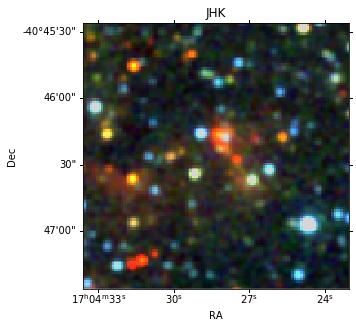

AGAL345.504+00.347


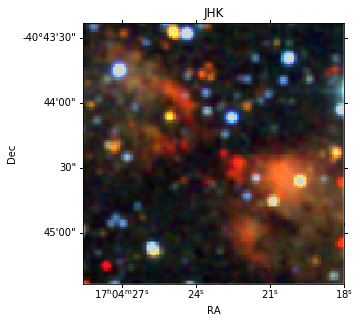

AGAL345.718+00.817


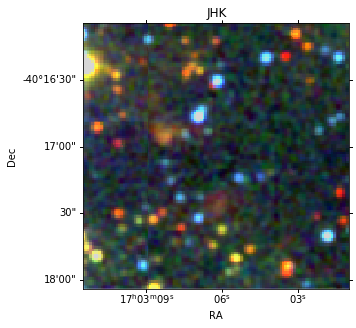

AGAL351.131+00.771


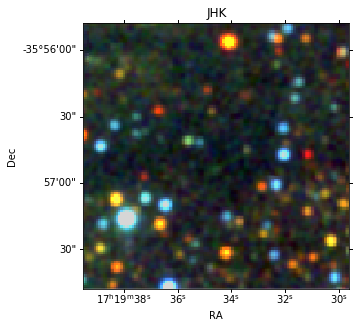

AGAL351.161+00.697


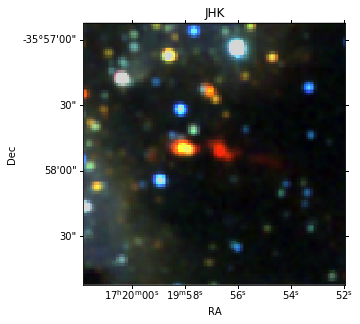

AGAL351.244+00.669


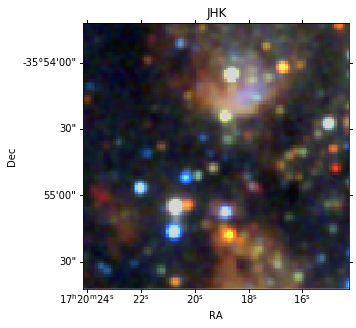

AGAL351.416+00.646


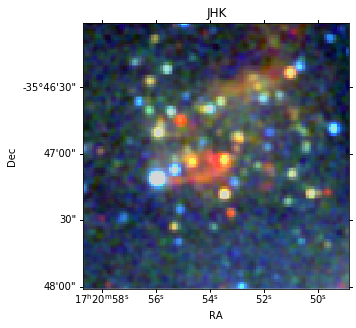

AGAL351.444+00.659


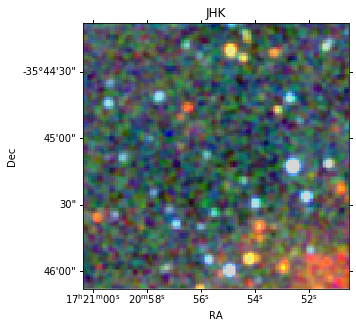

AGAL351.571+00.762


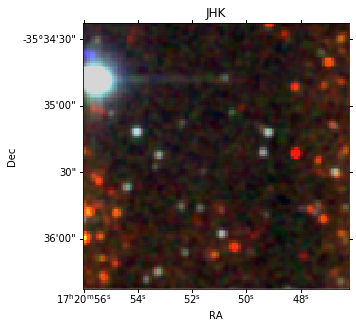

AGAL351.581-00.352


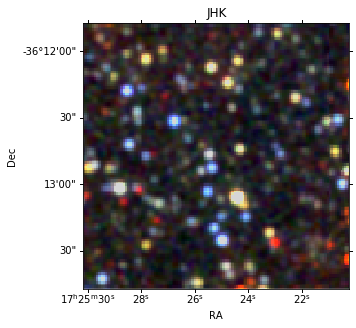

AGAL351.774-00.537


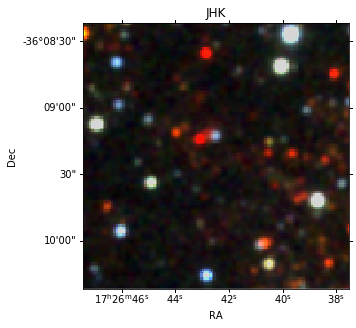

AGAL353.066+00.452


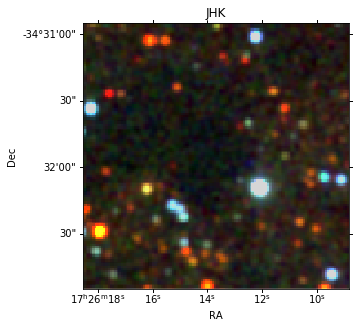

AGAL353.417-00.079


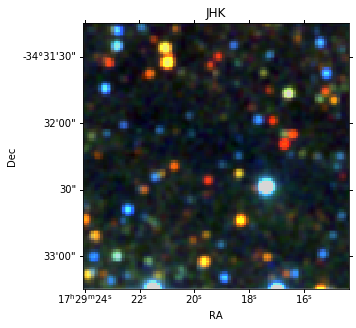

AGAL354.944-00.537


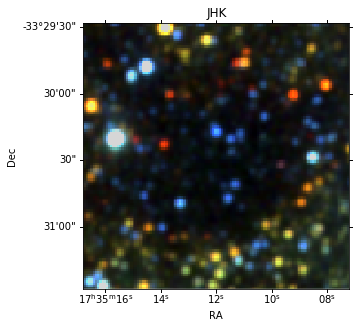

In [242]:
# convert coordinates
ra_hms =[]
for ra in data['RAJ2000']:
    ra_hms.append(ra.replace(' ',':'))
    
de_dms =[]
for de in data['DEJ2000']:
    de_dms.append(de.replace(' ',':'))
#de_dms

pos = coords.SkyCoord(ra_hms, de_dms, frame='icrs', unit=(u.hourangle,u.deg))
for index, csc in enumerate(data['CSC']):
    #print(index,csc,ra_hms[index], de_dms[index],pos[index])
    #print(index,csc,pos.ra[index])
    print(csc)
    query_2mass_rgb(pos.ra[index], pos.dec[index], 2.0, output='C:/Users/navar/Downloads/top100_2mass/rgb/'+csc+'.png', minmax=[0.001,0.99],rgb_Q=3,rgb_stretch=0.5)